In [ ]:
PROG_NAME = 'GradientHistAnalysis_V0'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

ValueError: mount failed

## Import

In [ ]:
import os
from collections import Counter
os.environ["TF_GPU_THREAD_MODE"] = "gpu_private"
import tensorflow as tf  # framework
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt
import datetime
import json
import shutil
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import zipfile
from keras import ops
from tqdm import tqdm
from typing import TypedDict, Literal,Union, List, Optional, Any

import pandas as pd
from pydantic import BaseModel, Field
from collections import defaultdict

import warnings
warnings.filterwarnings("ignore")

tf.config.optimizer.set_jit(True)

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

## Dataset

In [ ]:
def extract_zip(src_path, targ_path):
    with zipfile.ZipFile(src_path,"r") as zip_ref:
        zip_ref.extractall(targ_path)

In [ ]:
# !rm -r dataset

In [ ]:
src_train_test_path='/content/drive/MyDrive/representation_learning/pure_dataset/datasets/cifar10.zip'
targ_train_test_path='/content/dataset'
extract_zip(src_train_test_path, targ_train_test_path)

targ_train_path='/content/dataset/train'
targ_test_path='/content/dataset/test'

BATCH_SIZE = 1024
HEIGHT, WIDTH = 32, 32

In [ ]:
# src_train_path='/content/drive/MyDrive/representation_learning/LSMDWB_DataSet/cifar10_train.zip'
# src_test_path='/content/drive/MyDrive/representation_learning/LSMDWB_DataSet/cifar10_test.zip'

# targ_train_path='/content/dataset/cifar10_train'
# targ_test_path='/content/dataset/cifar10_test'

# extract_zip(src_train_path, targ_train_path)
# extract_zip(src_test_path, targ_test_path)

# BATCH_SIZE = 64
# HEIGHT, WIDTH = 32, 32

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0/255,
)

test_datagen = ImageDataGenerator(
    rescale = 1.0/255
)

train_generator = train_datagen.flow_from_directory(
    targ_train_path,
    target_size=(HEIGHT, WIDTH),
    batch_size= BATCH_SIZE,
    class_mode='categorical',
    # shuffle = False,
)

test_generator = test_datagen.flow_from_directory(
    targ_test_path,
    target_size = (HEIGHT, WIDTH),
    batch_size = BATCH_SIZE,
    class_mode = 'categorical',
)

TOTAL_TRAIN_SAMPLES = train_generator.n
TOTAL_VAL_SAMPLES = test_generator.n
CLASSMAP = train_generator.class_indices
NUM_LAB = len(train_generator.class_indices.keys())
T_STEPS_PER_EPOCH = len(train_generator)
V_STEPS_PER_EPOCH = len(test_generator)

## Utility Functions

In [ ]:
def save_result(result, path:str, type_:Literal["json","csv","keras","log"]):
  if type_ == "json":
      with open(path, 'w') as f:
          json.dump(result, f, indent=4)
  elif type_ == "csv":
      #  check if the result is a dataframe
      if isinstance(result, pd.DataFrame):
          result.to_csv(path, index=False)
      else:
          print("The result is not a dataframe")
          raise ValueError("The result is not a dataframe")
  elif type_ == "keras":
      result.save(path)
  elif type_ == "log":
      with open(path, 'a') as f:
          f.write(result)
  else:
      print("Invalid type")
      raise ValueError("Invalid type")


def get_stored_result(path:str, type_:Literal["json","csv","keras"]):
    # Check if the path is valid
    if not os.path.exists(path):
        return None
    if type_ == "json":
        with open(path, 'r') as f:
            data = json.load(f)
        return data
    elif type_ == "csv":
        with open(path, 'r') as f:
            data = json.load(f)
        return data
    elif type_ == "keras":
        return keras.models.load_model(path, compile=False)
    else:
        return None

In [ ]:

# finding the angle between two gradients
def angle_evaluator(gradient1, gradient2):
  """
  Input:
      - gradient1: List[Tensor]
      - gradient2: List[Tensor]

  Output:
      - angle: Float

  Here, angle is the angle in degree b/w gradient1 and gradient2
  """
  dot_product=0.0

  for grad1,grad2 in zip(gradient1,gradient2):
    dot_product+=tf.math.reduce_sum(tf.math.multiply(grad1,grad2))
  norm1 = norm_evaluator(gradient1)
  norm2 = norm_evaluator(gradient2)
  if norm1==0.0 or norm2==0.0:
    return 0.0
  return tf.math.acos(tf.math.divide(dot_product,tf.math.multiply(norm1,norm2)))/tf.constant(np.pi, dtype=tf.float32)*180

def norm_evaluator(grad):
  """
  Input:
      - grad: List[Tensor]

  Output:
      - Norm: Float

  Here, Norm is the norm of grad
  """
  norm=0.0
  for grad_ in grad:
    norm+=tf.math.reduce_sum(tf.math.square(grad_))
  norm = tf.math.sqrt(norm)
  return norm

def float_list_to_histogram(data, bin_count=10):
    counts, bin_edges = np.histogram(data, bins=bin_count)
    bin_ranges = [(bin_edges[i], bin_edges[i+1]) for i in range(len(bin_edges)-1)]
    histogram = {bin_range: count for bin_range, count in zip(bin_ranges, counts)}
    return histogram


def flatten_grad(grad):
  grad_flatten=[]
  for grad_ in grad:
    _grad_store=tf.reshape(grad_,[-1]).numpy().tolist()
    grad_flatten.extend(_grad_store)
  return grad_flatten

def grad_to_hist(grad, bin_count=100,clip=(-1e9,1e9)):
  grad_flatten=flatten_grad(grad)
  grad_flatten=np.clip(grad_flatten,clip[0],clip[1]) # Optional
  histogram = float_list_to_histogram(grad_flatten, bin_count=bin_count)
  histogram = {str(bin_range): np.array(count).astype('int32').tolist() for bin_range, count in histogram.items()}
  return histogram

def positional_difference(grad1_f,grad2_f, w1_f, w2_f, threshold=(-1e-9,1e-9)):
  grad1_flatten= np.array(grad1_f)
  grad2_flatten= np.array(grad2_f)
  w1_flatten= np.array(w1_f)
  w2_flatten= np.array(w2_f)

  if threshold == "Zero":
    pos1 = (grad1_flatten!=0.0)
    pos2 = (grad2_flatten!=0.0)
  else:
    pos1 = (grad1_flatten<threshold[0]) | (grad1_flatten>threshold[1])
    pos2 = (grad2_flatten<threshold[0]) | (grad2_flatten>threshold[1])

  no_zero_grad1 = pos1[pos1==False].size
  no_zero_grad2 = pos2[pos2==False].size
  no_zero_grad_retained = np.sum(pos2[pos1==False]==False)
  no_zero_grad_released = np.sum(pos2[pos1==False])

  pos_zero_grad1=np.where(pos1==False)[0].tolist()
  pos_zero_grad2=np.where(pos2==False)[0].tolist()
  pos_grad_0_0=np.where((pos1==False) & (pos2==False))[0].tolist()

  w_diff_0_0 = np.abs(w2_flatten-w1_flatten)[(pos1==False) & (pos2==False)].tolist()
  w2_val_0_0 = w2_flatten[(pos1==False) & (pos2==False)].tolist()
  g2_val_0_0 = grad2_flatten[(pos1==False) & (pos2==False)].tolist()

  g1g2_0_0 = (grad1_flatten*grad2_flatten)<0
  no_grad_flipped = np.sum(g1g2_0_0[(pos1==False) & (pos2==False)])

  pos_min_max_0_0 = ((np.sign((w2_flatten-w1_flatten)*(grad2_flatten-grad1_flatten))*g1g2_0_0)[(pos1==False) & (pos2==False)])
  no_min = (np.sum(pos_min_max_0_0==1))
  no_max = (np.sum(pos_min_max_0_0==-1))
  pos_min_max_0_0 = pos_min_max_0_0.astype('int32').tolist()

  return (
      no_zero_grad1,
      no_zero_grad2,
      no_zero_grad_retained,
      no_zero_grad_released,
      pos_zero_grad1,
      pos_zero_grad2,
      pos_grad_0_0,
      w_diff_0_0,
      w2_val_0_0,
      g2_val_0_0,
      no_grad_flipped,
      pos_min_max_0_0,
      no_min,
      no_max
  )



def gradient_difference_evaluator(grad1,grad2, bin_count=1000):
  grad1_flatten=[]
  grad2_flatten=[]
  for grad in grad1:
    _grad_store=tf.reshape(grad,[-1]).numpy().tolist()
    grad1_flatten.extend(_grad_store)

  for grad in grad2:
    _grad_store=tf.reshape(grad,[-1]).numpy().tolist()
    grad2_flatten.extend(_grad_store)

  grad1_flatten=np.array(grad1_flatten)
  grad2_flatten=np.array(grad2_flatten)
  grad_diff=abs(grad1_flatten-grad2_flatten)/abs(grad1_flatten+1e-9)

  histogram = float_list_to_histogram(grad_diff, bin_count=bin_count)
  return histogram

def weight_difference_evaluator(w1,w2):
  mean_layerwise_weight_difference=[]
  variance_layerwise_weight_difference=[]
  for layer_w1,layer_w2 in zip(w1,w2):
    mean_layerwise_weight_difference.append(tf.math.reduce_mean(tf.math.abs(layer_w1-layer_w2)).numpy().astype('float64'))
    variance_layerwise_weight_difference.append(tf.math.reduce_variance(tf.math.abs(layer_w1-layer_w2)).numpy().astype('float64'))

  return mean_layerwise_weight_difference,variance_layerwise_weight_difference

def plot_histogram_from_dict(histogram, show=True):
    # Extract the bin ranges and frequencies from the dictionary
    bin_ranges = list(histogram.keys())
    bin_ranges = [eval(bin_range) for bin_range in bin_ranges]
    frequencies = list(histogram.values())

    # Create a list of the midpoints of each bin for plotting
    bin_midpoints = [(bin_range[0] + bin_range[1]) / 2 for bin_range in bin_ranges]

    # Plot the histogram
    plt.bar(bin_midpoints, frequencies, width=[(bin_range[1] - bin_range[0]) for bin_range in bin_ranges])
    plt.xlabel('Value Range')
    plt.ylabel('Frequency')
    plt.title('Histogram')
    if show:
      plt.show()

In [ ]:
def calculate_stats(data):
    """Calculate statistics for the given data."""
    if len(data) == 0:
        return None  # Return None if the data list is empty

    data_np = np.array(data)
    stats = {
        "min": np.min(data_np),
        "max": np.max(data_np),
        "mean": np.mean(data_np),
        "median": np.median(data_np),
        "stddev": np.std(data_np, ddof=1)
    }
    return stats

def create_stats_dataframe(interim_results):
    """Create a DataFrame for the statistics."""
    data = []  # List to hold rows of data for the DataFrame

    # Iterate over interim_results and calculate stats
    for result_name in interim_results:
        for key, batch_data in interim_results[result_name].items():
            stats = calculate_stats(batch_data[-1])  # Calculate stats for the last batch

            if stats:  # Only add row if stats are valid
                data.append([
                    result_name,
                    key,
                    stats['min'],
                    stats['max'],
                    stats['mean'],
                    stats['median'],
                    stats['stddev']
                ])

    # Create a DataFrame from the collected data
    df = pd.DataFrame(data, columns=["Result Name", "Key", "Min", "Max", "Mean", "Median", "Stddev"])
    display(df)

## Custom Gradient Function

In [ ]:
def calculate_grad_and_sec_grad_from_batch(generator, model):
    # Get a batch of data from the generator
    x, y = next(generator)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)

    # Compute first-order derivatives
    with tf.GradientTape(persistent=True) as tape1:
        tape1.watch(x)  # Watch the input x
        with tf.GradientTape() as tape2:
            tape2.watch(x)  # Watch the input x for second-order derivatives
            y_pred = model(x)  # Forward pass
            loss = tf.keras.losses.categorical_crossentropy(y, y_pred)  # Loss

        grad = tape2.gradient(loss, model.trainable_variables)
    second_order_grad = tape1.gradient(grad, model.trainable_variables)

    del tape1
    del tape2

    return grad, second_order_grad

## Testing

In [ ]:
# sample_grad1, sample_second_order_grad1 = calculate_grad_and_sec_grad_from_batch(train_generator, build_model())
# sample_grad2, sample_second_order_grad2 = calculate_grad_and_sec_grad_from_batch(test_generator, build_model())

# sample_grads1_flatten = np.array(flatten_grad(sample_grad1))
# sample_grads2_flatten = np.array(flatten_grad(sample_grad2))

# sample_second_order_grad1_flatten = np.array(flatten_grad(sample_second_order_grad1))
# sample_second_order_grad2_flatten = np.array(flatten_grad(sample_second_order_grad2))

In [ ]:
# print(sample_grads2_flatten)

In [ ]:
# calculate_stats(sample_grads2_flatten)

In [ ]:
# histogram1 =grad_to_hist(sample_grad1, 1000)#, clip=(-1,1))
# histogram2 =grad_to_hist(sample_grad2, 1000)#, clip=(-1,1))

In [ ]:
# len(sample_grads1_flatten)

In [ ]:
# pos1 = (sample_grads1_flatten<-1e-6) | (sample_grads1_flatten>1e-6)
# pos2 = (sample_grads2_flatten<-1e-5) | (sample_grads2_flatten>1e-5)

# pos1 = root(sample_grads1_flatten^2) < 1e-12

# pos1 = (sample_grads1_flatten!=0)
# pos2 = (sample_grads2_flatten!=0)

In [ ]:
# print(f"{np.sum(pos1[pos1==False] ^ pos2[pos1==False])} / {np.size(pos1[pos1==False])}")

In [ ]:
# print(histogram1)

In [ ]:
# np.median(grad_flatten)

In [ ]:
# plt.figure(figsize=(20,5))
# plt.plot(grad_flatten)
# plt.show()

In [ ]:
# plot_histogram_from_dict(histogram2)

In [ ]:
# histogram.items()
# # print(np.unique(list(histogram.values())))

In [ ]:
# (
#         no_zero_grad1,
#         no_zero_grad2,
#         no_zero_grad_retained,
#         no_zero_grad_released,
#         pos_zero_grad1,
#         pos_zero_grad2,
#         pos_grad_0_0,
#         w_diff_0_0,
#         no_grad_flipped,
#         pos_min_max_0_0,
#         no_min,
#         no_max
#     ) = positional_difference(sample_grads1_flatten, sample_grads2_flatten, sample_grads2_flatten, sample_grads1_flatten, threshold="Zero")

In [ ]:
# print((no_zero_grad1,
#   no_zero_grad2,
#   no_zero_grad_retained,
#   no_zero_grad_released,
#   # pos_zero_grad1,
#   # pos_zero_grad2,
#   # pos_grad_0_0,
#   # w_diff_0_0,
#   no_grad_flipped,
#   # pos_min_max_0_0,
#   no_min,
#   no_max))

In [ ]:
# (
#         no_zero_grad1,
#         no_zero_grad2,
#         no_zero_grad_retained,
#         no_zero_grad_released,
#         pos_zero_grad1,
#         pos_zero_grad2,
#         pos_grad_0_0,
#         w_diff_0_0,
#         no_grad_flipped,
#         pos_min_max_0_0,
#         no_min,
#         no_max
#     ) = positional_difference_(sample_grad1, sample_grad2, sample_grad2, sample_grad1, threshold="Zero")

In [ ]:
# print((no_zero_grad1,
#   no_zero_grad2,
#   no_zero_grad_retained,
#   no_zero_grad_released,
#   # pos_zero_grad1,
#   # pos_zero_grad2,
#   # pos_grad_0_0,
#   # w_diff_0_0,
#   no_grad_flipped,
#   # pos_min_max_0_0,
#   no_min,
#   no_max))

In [ ]:
# print((no_zero_grad1,
#       no_zero_grad2,
#       no_zero_grad_retained,
#       no_zero_grad_released,
#       no_positive_sec_grad1_at_zero_grad,
#       no_positive_sec_grad2_at_zero_grad,
#       no_positive_sec_grad1_at_zero_grad_retained,
#       no_positive_sec_grad1_at_zero_grad_released,
#       pos_zero_grad1,
#       pos_zero_grad2))

In [ ]:
# calculate_stats(pos_zero_grad2)

In [ ]:
# np.diff(pos_zero_grad2)

In [ ]:
# plt.figure(figsize=(20,5))
# plt.scatter(x=pos_zero_grad2, y=[0]*pos_zero_grad2.size, s=100)
# plt.xlim(287916,300000)  # 2_87_916 refers to the minimum value of the pos_zero_grad2
# plt.show()

In [ ]:
# my_model.model.summary()

In [ ]:
# print(pos_zero_grad2)

In [ ]:
# print(10040+18496+37284+74468+148096)

In [ ]:
# counter=0
# for layer_grad in sample_grad1:
#   counter+=np.array(layer_grad).size
#   print(layer_grad.shape)
#   print(f" Till now, we have {counter} parameters")

### Cutsom Callback Deifinition

## Custom Callback

In [ ]:
class MyCallBack(tf.keras.callbacks.Callback):
  def __init__(self, **kwargs):
    super().__init__()

    self._model = kwargs.get("model", None)
    self._train_generator = kwargs.get("train_generator", None)
    self._load_model_path = kwargs.get("load_model_path", None)
    self._load_interim_results_path = kwargs.get("load_interim_results_path", None)
    self.bin_count= kwargs.get("bin_count",1000)
    self.clip=kwargs.get("clip",(-1e9,1e9))
    self.save_check_periodically=kwargs.get("save_check_periodically",False)
    self.periodic_save_dir_path=kwargs.get("periodic_save_dir_path",None)
    self.period=kwargs.get("period",5)

    self.interim_results={
        "batch_wise":{
            "g_cur_hist":[],
            "train_loss":[],
            "no_zero_e7_grad1":[],
            "no_zero_e7_grad2":[],
            "no_zero_e7_grad_retained":[],
            "no_zero_e7_grad_released":[],
            "pos_zero_e7_grad2":[],
            "fraction_zeros_e7_released":[],
            "no_zero_e5_grad1":[],
            "no_zero_e5_grad2":[],
            "no_zero_e5_grad_retained":[],
            "no_zero_e5_grad_released":[],
            "pos_zero_e5_grad2":[],
            "fraction_zeros_e5_released":[],

            "no_zero_e7_grad2_09avg":[],
            "no_zero_e5_grad2_09avg":[],
            "no_zero_e7_grad_released_09avg":[],
            "no_zero_e5_grad_released_09avg":[],
            "fraction_zeros_e7_released_09avg":[],
            "fraction_zeros_e5_released_09avg":[],
            "pos_zero_e7_grad2_09avg":[],
            "pos_zero_e5_grad2_09avg":[],

            "pos_grad_0_0_e7":[],
            "pos_grad_0_0_e5":[],

            "w_diff_0_0_e7":[],
            "w_diff_0_0_e5":[],

            "w2_val_0_0_e7":[],
            "w2_val_0_0_e5":[],
            "g2_val_0_0_e7":[],
            "g2_val_0_0_e5":[],

            "w2_val_0_0_e7_09avg":[],
            "w2_val_0_0_e5_09avg":[],
            "g2_val_0_0_e7_09avg":[],
            "g2_val_0_0_e5_09avg":[],

            "no_grad_flipped_e7":[],
            "no_grad_flipped_e5":[],

            "fraction_grad_flipped_e7":[],
            "fraction_grad_flipped_e5":[],
            "fraction_grad_flipped_e7_09avg":[],
            "fraction_grad_flipped_e5_09avg":[],

            "pos_min_max_0_0_e7":[],
            "no_min_e7":[],
            "no_max_e7":[],
            "no_min_e7_09avg":[],
            "no_max_e7_09avg":[],

            "pos_min_max_0_0_e5":[],
            "no_min_e5":[],
            "no_max_e5":[],
            "no_min_e5_09avg":[],
            "no_max_e5_09avg":[],
        },
        "epoch_wise":{
            "train_mean_loss":[],
            "val_mean_loss":[],
            "train_mean_acc":[],
            "val_mean_acc":[]
        }
    }

    self.summary_writer={}


    self.load_model_and_results()

    _dummy_gradient,_dummy_sec_gradient  = calculate_grad_and_sec_grad_from_batch(self._train_generator,self._model)

    self.variables = {
        "model": self._model,
        "g_cur": flatten_grad(_dummy_gradient),
        "g_prev": flatten_grad(_dummy_gradient),
        "g_cur_09avg": flatten_grad(_dummy_gradient),
        "g_prev_09avg": flatten_grad(_dummy_gradient),
        "sec_g_cur": flatten_grad(_dummy_sec_gradient),
        "sec_g_prev": flatten_grad(_dummy_sec_gradient),
        "w_cur": flatten_grad(self.model.trainable_variables),
        "w_prev": flatten_grad(self.model.trainable_variables),
        "w_cur_09avg": flatten_grad(self.model.trainable_variables),
        "w_prev_09avg": flatten_grad(self.model.trainable_variables),
    }

    self.t_steps_per_epoch=len(self._train_generator)

    self.reset_pbar()
    self.update_logs_directory()
    self.epoch = len(self.interim_results["epoch_wise"]['train_mean_loss'])

   # Create directory for periodic saving if it does not exist
    if self.periodic_save_dir_path is not None:
        if not os.path.exists(self.periodic_save_dir_path):
            os.makedirs(self.periodic_save_dir_path)

  def load_model_and_results(self):
    if self._load_model_path is not None and os.path.exists(self._load_model_path):
      print(f"Loaded model from {self._load_model_path}")
      self._model = get_stored_result(self._load_model_path, type_ = "keras")

    if self._model==None:
      self._model=build_model()

    if self._load_interim_results_path is not None and os.path.exists(self._load_interim_results_path):
      print(f"Loaded interim results from {self._load_interim_results_path}")
      self.interim_results = get_stored_result(self._load_interim_results_path, type_ = "json")

  def store_model_and_results(self, store_model_path, store_interim_results_path):
    save_result(self.variables['model'], store_model_path, type_ = "keras")
    save_result(self.interim_results, store_interim_results_path, type_ = "json")

  def reset_pbar(self):
    self.pbar = tqdm(
        total=self.t_steps_per_epoch,
        position=0,
        leave=True,
        bar_format='{l_bar}{bar}| {n_fmt}/{total_fmt} ')

  # Initializes /content/logs/ followed by creation of sub-log directories according to the hierarchy of the interim results
  def initialize_logs_directory(self):
    try:
      shutil.rmtree(f"/content/logs/")
    except:
      pass

    print('Initializing the summary writer')
    summary_writer={}
    for result_key,results in self.interim_results.items():
      summary_writer[result_key]={}
      for key,item in results.items():
        summary_writer[result_key][key]=tf.summary.create_file_writer(f"/content/logs/{result_key}/{key}")
    self.summary_writer=summary_writer
    return summary_writer

  # Updates the summary writer according to the interim results
  def update_logs_directory(self):

    # If the summary writer is not yet initialized
    if self.summary_writer=={}:
      self.initialize_logs_directory()

    # Updates the value of mean result for each keys for each epoch in the interim_results
    for result_key,results in self.interim_results.items():
      for key,items in results.items():
        if 'hist' in key or 'pos' in key or 'w_diff' in key or '2_val_' in key:
          continue
        values=items
        # Batch results are averaged wrt each epochs

        if 'batch' in result_key.lower():
            values=[np.mean(item) for item in items]
        for epoch,value in enumerate(values):
          with self.summary_writer[result_key][key].as_default():
            label_text=f"{result_key}/{key}"
            if 'train' in  key.lower():
              label_text=key.split('train_')[-1]
            if 'val' in key.lower():
              label_text=key.split('val_')[-1]
            tf.summary.scalar(label_text,value,step=epoch)


  def on_train_batch_begin(self, batch, logs=None):
    pass

  def on_train_batch_end(self, batch, logs=None):
    verbose_description=""
    # Updating Variable
    ## Gradients
    self.variables["g_prev"] = self.variables["g_cur"]
    self.variables["g_cur"] = flatten_grad(logs["grads"])

    # Moving average of Gradients
    self.variables["g_prev_09avg"] =  self.variables["g_cur_09avg"]
    self.variables["g_cur_09avg"] = (0.9*np.array(self.variables["g_cur_09avg"]) + 0.1*np.array(self.variables["g_cur"])).tolist()

    ## Second order gradients
    self.variables["sec_g_prev"] = self.variables["sec_g_cur"]
    self.variables["sec_g_cur"] = flatten_grad(logs["second_order_grads"])

    ## Weights
    self.variables["w_prev"] = self.variables["w_cur"]
    self.variables["w_cur"] = flatten_grad(logs['weights'])

    ## Moving average of Weights
    self.variables["w_prev_09avg"] =  self.variables["w_cur_09avg"]
    self.variables["w_cur_09avg"] = (0.9*np.array(self.variables["w_cur_09avg"]) + 0.1*np.array(self.variables["w_cur"])).tolist()

    ## Model
    self.variables["model"] = self.model.model

    # Evaluating results
    grad_hist = grad_to_hist(logs["grads"],bin_count=self.bin_count, clip=self.clip)

    ( no_zero_e7_grad1,
      no_zero_e7_grad2,
      no_zero_e7_grad_retained,
      no_zero_e7_grad_released,
      pos_zero_e7_grad1,
      pos_zero_e7_grad2,
      pos_grad_0_0_e7,
      w_diff_0_0_e7,
      w2_val_0_0_e7,
      g2_val_0_0_e7,
      no_grad_flipped_e7,
      pos_min_max_0_0_e7,
      no_min_e7,
      no_max_e7,
      ) = positional_difference(self.variables["g_prev"],self.variables["g_cur"], self.variables["w_prev"],self.variables["w_cur"],threshold=(-1e-7,1e-7))

    ( no_zero_e5_grad1,
      no_zero_e5_grad2,
      no_zero_e5_grad_retained,
      no_zero_e5_grad_released,
      pos_zero_e5_grad1,
      pos_zero_e5_grad2,
      pos_grad_0_0_e5,
      w_diff_0_0_e5,
      w2_val_0_0_e5,
      g2_val_0_0_e5,
      no_grad_flipped_e5,
      pos_min_max_0_0_e5,
      no_min_e5,
      no_max_e5
      ) = positional_difference(self.variables["g_prev"],self.variables["g_cur"], self.variables["w_prev"],self.variables["w_cur"],threshold=(-1e-5,1e-5))

    (
        no_zero_e7_grad1_09avg,
        no_zero_e7_grad2_09avg,
        no_zero_e7_grad_retained_09avg,
        no_zero_e7_grad_released_09avg,
        pos_zero_e7_grad1_09avg,
        pos_zero_e7_grad2_09avg,
        pos_grad_0_0_e7_09avg,
        w_diff_0_0_e7_09avg,
        w2_val_0_0_e7_09avg,
        g2_val_0_0_e7_09avg,
        no_grad_flipped_e7_09avg,
        pos_min_max_0_0_e7_09avg,
        no_min_e7_09avg,
        no_max_e7_09avg,
    ) = positional_difference(self.variables["g_prev_09avg"],self.variables["g_cur_09avg"], self.variables["w_prev"],self.variables["w_cur"],threshold=(-1e-7,1e-7))


    (
        no_zero_e5_grad1_09avg,
        no_zero_e5_grad2_09avg,
        no_zero_e5_grad_retained_09avg,
        no_zero_e5_grad_released_09avg,
        pos_zero_e5_grad1_09avg,
        pos_zero_e5_grad2_09avg,
        pos_grad_0_0_e5_09avg,
        w_diff_0_0_e5_09avg,
        w2_val_0_0_e5_09avg,
        g2_val_0_0_e5_09avg,
        no_grad_flipped_e5_09avg,
        pos_min_max_0_0_e5_09avg,
        no_min_e5_09avg,
        no_max_e5_09avg
    ) = positional_difference(self.variables["g_prev_09avg"],self.variables["g_cur_09avg"], self.variables["w_prev"],self.variables["w_cur"],threshold=(-1e-5,1e-5))



    fraction_zeros_e5_released = no_zero_e5_grad_released/(no_zero_e5_grad1+1e-9)
    fraction_zeros_e7_released = no_zero_e7_grad_released/(no_zero_e7_grad1+1e-9)
    fraction_zeros_e5_released_09avg = no_zero_e5_grad_released_09avg/(no_zero_e5_grad1_09avg+1e-9)
    fraction_zeros_e7_released_09avg = no_zero_e7_grad_released_09avg/(no_zero_e7_grad1_09avg+1e-9)

    fraction_grad_flipped_e7 = no_grad_flipped_e7/(no_zero_e7_grad_retained+1e-9)
    fraction_grad_flipped_e5 = no_grad_flipped_e5/(no_zero_e5_grad_retained+1e-9)
    fraction_grad_flipped_e7_09avg = no_grad_flipped_e7_09avg/(no_zero_e7_grad_retained_09avg+1e-9)
    fraction_grad_flipped_e5_09avg = no_grad_flipped_e5_09avg/(no_zero_e5_grad_retained_09avg+1e-9)
    # Adding to interim results


    if batch%30==0: # After each 30 batches
      self.interim_results['batch_wise']['g_cur_hist'][-1].append(grad_hist)
      self.interim_results['batch_wise']['pos_zero_e7_grad2'][-1].append(pos_zero_e7_grad2)
      self.interim_results['batch_wise']['pos_zero_e5_grad2'][-1].append(pos_zero_e5_grad2)
      self.interim_results['batch_wise']['pos_zero_e7_grad2_09avg'][-1].append(pos_zero_e7_grad2_09avg)
      self.interim_results['batch_wise']['pos_zero_e5_grad2_09avg'][-1].append(pos_zero_e5_grad2_09avg)
      self.interim_results['batch_wise']['pos_grad_0_0_e7'][-1].append(pos_grad_0_0_e7)
      self.interim_results['batch_wise']['pos_grad_0_0_e5'][-1].append(pos_grad_0_0_e5)
      self.interim_results['batch_wise']['w_diff_0_0_e5'][-1].append(w_diff_0_0_e5)
      self.interim_results['batch_wise']['w_diff_0_0_e7'][-1].append(w_diff_0_0_e7)
      self.interim_results['batch_wise']['w2_val_0_0_e5'][-1].append(w2_val_0_0_e5)
      self.interim_results['batch_wise']['w2_val_0_0_e7'][-1].append(w2_val_0_0_e7)
      self.interim_results['batch_wise']['g2_val_0_0_e5'][-1].append(g2_val_0_0_e5)
      self.interim_results['batch_wise']['g2_val_0_0_e7'][-1].append(g2_val_0_0_e7)
      self.interim_results['batch_wise']['w2_val_0_0_e5_09avg'][-1].append(w2_val_0_0_e5_09avg)
      self.interim_results['batch_wise']['w2_val_0_0_e7_09avg'][-1].append(w2_val_0_0_e7_09avg)
      self.interim_results['batch_wise']['g2_val_0_0_e5_09avg'][-1].append(g2_val_0_0_e5_09avg)
      self.interim_results['batch_wise']['g2_val_0_0_e7_09avg'][-1].append(g2_val_0_0_e7_09avg)
      self.interim_results['batch_wise']['pos_min_max_0_0_e5'][-1].append(pos_min_max_0_0_e5)
      self.interim_results['batch_wise']['pos_min_max_0_0_e7'][-1].append(pos_min_max_0_0_e7)


    self.interim_results['batch_wise']['train_loss'][-1].append(logs['train_loss'])

    self.interim_results['batch_wise']['no_zero_e7_grad1'][-1].append(int(no_zero_e7_grad1))
    self.interim_results['batch_wise']['no_zero_e7_grad2'][-1].append(int(no_zero_e7_grad2))
    self.interim_results['batch_wise']['no_zero_e7_grad_retained'][-1].append(int(no_zero_e7_grad_retained))
    self.interim_results['batch_wise']['no_zero_e7_grad_released'][-1].append(int(no_zero_e7_grad_released))


    self.interim_results['batch_wise']['no_zero_e7_grad2_09avg'][-1].append(int(no_zero_e7_grad2_09avg))
    self.interim_results['batch_wise']['no_zero_e7_grad_released_09avg'][-1].append(int(no_zero_e7_grad_released_09avg))

    self.interim_results['batch_wise']['no_zero_e5_grad1'][-1].append(int(no_zero_e5_grad1))
    self.interim_results['batch_wise']['no_zero_e5_grad2'][-1].append(int(no_zero_e5_grad2))
    self.interim_results['batch_wise']['no_zero_e5_grad_retained'][-1].append(int(no_zero_e5_grad_retained))
    self.interim_results['batch_wise']['no_zero_e5_grad_released'][-1].append(int(no_zero_e5_grad_released))

    self.interim_results['batch_wise']['no_zero_e5_grad2_09avg'][-1].append(int(no_zero_e5_grad2_09avg))
    self.interim_results['batch_wise']['no_zero_e5_grad_released_09avg'][-1].append(int(no_zero_e5_grad_released_09avg))

    self.interim_results['batch_wise']['no_grad_flipped_e7'][-1].append(int(no_grad_flipped_e7))
    self.interim_results['batch_wise']['no_grad_flipped_e5'][-1].append(int(no_grad_flipped_e5))

    self.interim_results['batch_wise']['no_min_e7'][-1].append(int(no_min_e7))
    self.interim_results['batch_wise']['no_max_e7'][-1].append(int(no_max_e7))
    self.interim_results['batch_wise']['no_min_e5'][-1].append(int(no_min_e5))
    self.interim_results['batch_wise']['no_max_e5'][-1].append(int(no_max_e5))

    self.interim_results['batch_wise']['no_min_e7_09avg'][-1].append(int(no_min_e7_09avg))
    self.interim_results['batch_wise']['no_max_e7_09avg'][-1].append(int(no_max_e7_09avg))
    self.interim_results['batch_wise']['no_min_e5_09avg'][-1].append(int(no_min_e5_09avg))
    self.interim_results['batch_wise']['no_max_e5_09avg'][-1].append(int(no_max_e5_09avg))

    self.interim_results['batch_wise']['fraction_zeros_e7_released'][-1].append(fraction_zeros_e7_released)
    self.interim_results['batch_wise']['fraction_zeros_e5_released'][-1].append(fraction_zeros_e5_released)
    self.interim_results['batch_wise']['fraction_zeros_e7_released_09avg'][-1].append(fraction_zeros_e7_released_09avg)
    self.interim_results['batch_wise']['fraction_zeros_e5_released_09avg'][-1].append(fraction_zeros_e5_released_09avg)
    self.interim_results['batch_wise']['fraction_grad_flipped_e5'][-1].append(fraction_grad_flipped_e5)
    self.interim_results['batch_wise']['fraction_grad_flipped_e7'][-1].append(fraction_grad_flipped_e7)
    self.interim_results['batch_wise']['fraction_grad_flipped_e5_09avg'][-1].append(fraction_grad_flipped_e5_09avg)
    self.interim_results['batch_wise']['fraction_grad_flipped_e7_09avg'][-1].append(fraction_grad_flipped_e7_09avg)


    verbose_description+=f"Train Loss: {logs['train_loss']:.4f}"

    verbose_description+=f" , No of zero_e7 grads1 : {no_zero_e7_grad1}"
    verbose_description+=f" , No of zero_e5 grads1 : {no_zero_e5_grad1}"

    verbose_description+=f" , No of zero_e7 grads released : {no_zero_e7_grad_released}"
    verbose_description+=f" , No of zero_e5 grads released : {no_zero_e5_grad_released}"

    verbose_description+=f" , No of zero_e7 grads_09avg released : {no_zero_e7_grad_released_09avg}"
    verbose_description+=f" , No of zero_e5 grads_09avg released : {no_zero_e5_grad_released_09avg}"



    verbose_description+=f" , Fraction of zeros_e7 released : {fraction_zeros_e7_released:.4f}"
    verbose_description+=f" , Fraction of zeros_e5 released : {fraction_zeros_e5_released:.4f}"

    verbose_description+=f" , Fraction of zeros_e7_09avg released : {fraction_zeros_e7_released_09avg:.4f}"
    verbose_description+=f" , Fraction of zeros_e5_09avg released : {fraction_zeros_e5_released_09avg:.4f}"

    verbose_description+=f" , No of zero_e7 grads retained : {no_zero_e7_grad_retained}"
    verbose_description+=f" , No of zero_e5 grads retained : {no_zero_e5_grad_retained}"

    verbose_description+=f" , No of grad flipped_e7 : {no_grad_flipped_e7}"
    verbose_description+=f" , No of grad flipped_e5 : {no_grad_flipped_e5}"

    verbose_description+=f" , Fraction of grad flipped_e7 : {fraction_grad_flipped_e7:.4f}"
    verbose_description+=f" , Fraction of grad flipped_e5 : {fraction_grad_flipped_e5:.4f}"

    verbose_description+=f" , Min/Max of grad_e7 : {no_min_e7}/{no_max_e7}"
    verbose_description+=f" , Min/Max of grad_e5 : {no_min_e5}/{no_max_e5}"
    verbose_description+=f" , Min/Max of grad_e7 09avg : {no_min_e7_09avg}/{no_max_e7_09avg}"
    verbose_description+=f" , Min/Max of grad_e5 09avg : {no_min_e5_09avg}/{no_max_e5_09avg}"


    self.pbar.set_description(verbose_description)
    self.pbar.update()


  def on_epoch_begin(self, epoch, logs=None):
    self.epoch+=1
    print(f"\nEpoch {self.epoch} started")
    for key in self.interim_results['batch_wise']:
      self.interim_results['batch_wise'][key].append([])

  def on_epoch_end(self, epoch, logs=None):
    train_mean_loss = logs['train_mean_loss']
    val_mean_loss = logs['val_mean_loss']
    train_mean_acc = logs['train_mean_acc']
    val_mean_acc = logs['val_mean_acc']

    # Adding to interim results
    self.interim_results['epoch_wise']['train_mean_loss'].append(train_mean_loss)
    self.interim_results['epoch_wise']['val_mean_loss'].append(val_mean_loss)
    self.interim_results['epoch_wise']['train_mean_acc'].append(train_mean_acc)
    self.interim_results['epoch_wise']['val_mean_acc'].append(val_mean_acc)

    print("\n")
    for key,val in self.interim_results['epoch_wise'].items():
      print(f'{key}:{val[-1]:.4f}')
    print("\n Latest Gradient Stats :")
    print(calculate_stats(self.variables['g_cur']))


    print('Statistics of the latest weight difference, when the current and the previous gradients become 0')
    print('e7:', calculate_stats(self.interim_results['batch_wise']['w_diff_0_0_e7'][-1][-1]))
    print('e5:', calculate_stats(self.interim_results['batch_wise']['w_diff_0_0_e5'][-1][-1]))
    print("\n")

    # Updates log directory of TensorBoard
    self.update_logs_directory()

    if self.save_check_periodically and (self.epoch)%self.period==0:
      self.store_model_and_results(store_model_path=f"{self.periodic_save_dir_path}/{PROG_NAME}.keras", store_interim_results_path=f"{self.periodic_save_dir_path}/{PROG_NAME}.json")
      # The logs are appended at {self.periodic_save_dir_path}/{PROG_NAME}.logs to track the progress of the model
      log_text = f"""
      -- Checkpoint Stored --
      Time: {datetime.datetime.now().strftime('%Y-%m-%d %H:%M:%S')},
      Epoch (1 based): {self.epoch},
      Model saved at {self.periodic_save_dir_path}/{PROG_NAME}.keras,
      Metadata saved at {self.periodic_save_dir_path}/{PROG_NAME}.json
      --         --          --
      """
      print(log_text)
      save_result(log_text,f"{self.periodic_save_dir_path}/{PROG_NAME}.log","log")

    self.pbar.close()
    self.reset_pbar()



## LR Callback

In [ ]:
# Scheduler for Learning rate (To be used in LR Callback)
def scheduler(epoch, lr):
  return lr
  # if epoch < 10:
  #     return lr
  # elif epoch%10==0:
  #   print(f"Learning rate set to {lr}")
  #   return float(lr * 0.95)
  # else:
  #   return lr
    # return float(lr * ops.exp(-0.1))

## Building Model


In [ ]:
def build_model():
    inputs = tf.keras.layers.Input(shape=(HEIGHT, WIDTH,3))

    # First Conv Block
    x = tf.keras.layers.Conv2D(32, (3,3), padding='same', activation='relu')(inputs)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Conv2D(32, (3,3), padding='same', activation='relu')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.MaxPooling2D(pool_size=(2,2))(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # Second Conv Block
    x = tf.keras.layers.Conv2D(64, (3,3), padding='same', activation='relu')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Conv2D(64, (3,3), padding='same', activation='relu')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.MaxPooling2D(pool_size=(2,2))(x)
    x = tf.keras.layers.Dropout(0.5)(x)

    # Third Conv Block
    x = tf.keras.layers.Conv2D(128, (3,3), padding='same', activation='relu')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Conv2D(128, (3,3), padding='same', activation='relu')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.MaxPooling2D(pool_size=(2,2))(x)
    x = tf.keras.layers.Dropout(0.5)(x)

    # Fully Connected Layers
    x = tf.keras.layers.Flatten()(x)
    x = tf.keras.layers.Dense(128, activation='relu')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Dropout(0.5)(x)

    # Output Layer
    outputs = tf.keras.layers.Dense(NUM_LAB, activation='softmax')(x)

    # Model creation
    model = tf.keras.models.Model(inputs, outputs)

    return model

In [ ]:
class MyModel(keras.Model):
    def __init__(self,load_model_path:str=None):
        super().__init__()
        if load_model_path is not None:
          print(load_model_path)
          self.model=get_stored_result(load_model_path,"keras")
        else:
          self.model = build_model()
        # self.build(input_shape=(None,HEIGHT, WIDTH,3))
        self.model.build(input_shape=(None,HEIGHT, WIDTH,3))
        self.setup_trackers()


    @property
    def metrics(self):
        return [
            self.train_loss_tracker,
            self.train_acc_tracker,
            self.val_loss_tracker,
            self.val_acc_tracker
            ]

    def compile(self, loss_obj, optimizer_obj):
        super().compile()
        self.loss_obj = loss_obj
        self.optimizer = optimizer_obj

    def setup_trackers(self):
        self.train_loss_tracker = keras.metrics.Mean(name="train_loss")
        self.train_acc_tracker = keras.metrics.CategoricalAccuracy(name="train_acc")
        self.val_loss_tracker = keras.metrics.Mean(name="val_loss")
        self.val_acc_tracker = keras.metrics.CategoricalAccuracy(name="val_acc")

    def train_step(self, batch: tf.Tensor) -> tf.Tensor:
        x,y_true = batch

        with tf.GradientTape(persistent=True) as tape1:
            tape1.watch(x)
            with tf.GradientTape() as tape2:
                tape2.watch(x)
                y_pred = self.model(x, training=True)
                loss = self.loss_obj(y_true,y_pred)
            grad = tape2.gradient(loss, self.model.trainable_variables)
        second_order_grad = tape1.gradient(grad, self.model.trainable_variables)

        self.optimizer.apply_gradients(zip(grad, self.model.trainable_variables))

        w = self.model.trainable_variables

        self.train_loss_tracker.update_state(loss)
        self.train_acc_tracker.update_state(y_true,y_pred)

        del tape1
        del tape2

        return {
            "train_loss": loss,
            "train_mean_loss": self.train_loss_tracker.result(),
            "train_mean_acc": self.train_acc_tracker.result(),
            "grads": grad,
            "second_order_grads": second_order_grad,
            "weights": w
            }


    def test_step(self, batch: tf.Tensor) -> tf.Tensor:
        x,y_true = batch
        y_pred = self.model(x, training=False)
        loss = self.loss_obj(y_true,y_pred)
        self.val_loss_tracker.update_state(loss)
        self.val_acc_tracker.update_state(y_true,y_pred)
        return {
            "loss": loss,
            "mean_loss": self.val_loss_tracker.result(),
            "mean_acc": self.val_acc_tracker.result(),
        }

    def __call__(self, x):
        return self.model(x)


## Model Training

#### Load Previous Result

In [ ]:
load_interim_results_path=None
load_model_path=None

In [ ]:
# # Loading from Default
# load_ver = "4"
# load_model_path = f"/content/drive/MyDrive/representation_learning/results/models/{PROG_NAME}_{load_ver}.keras"
# load_interim_results_path = f"/content/drive/MyDrive/representation_learning/results/metadatas/{PROG_NAME}_{load_ver}.json"


# Loading from checkpoints
load_checkpoint_ver = "4"
load_periodic_save_dir_path = f"/content/drive/MyDrive/representation_learning/results/checkpoints/{PROG_NAME}/{load_checkpoint_ver}"
load_model_path = f"{load_periodic_save_dir_path}/{PROG_NAME}.keras"
load_interim_results_path = f"{load_periodic_save_dir_path}/{PROG_NAME}.json"

#### Compiling And Run

In [ ]:
my_model=MyModel(load_model_path=load_model_path)
my_model.compile(
    loss_obj = tf.keras.losses.CategoricalCrossentropy(),
    optimizer_obj = tf.keras.optimizers.Adam(learning_rate=1e-2)
)

/content/drive/MyDrive/representation_learning/results/checkpoints/GradientHistAnalysis_V0/4/GradientHistAnalysis_V0.keras


### Initializing the callbacks

In [ ]:
# Custom Callback to register metadata and metrics
save_checkpoint_ver = "4"

save_periodic_save_dir_path=f"/content/drive/MyDrive/representation_learning/results/checkpoints/{PROG_NAME}/{save_checkpoint_ver}"

my_call_back=MyCallBack(
    save_check_periodically=True,
    periodic_save_dir_path=save_periodic_save_dir_path,
    period=5,
    load_interim_results_path = load_interim_results_path,
    load_model_path = load_model_path,
    train_generator=train_generator,
    bin_count=1000,
    clip=(-1e9,1e9)
)

# Learning rate scheduler
lr_call_back = keras.callbacks.LearningRateScheduler(scheduler)

calbacks=[my_call_back,lr_call_back]

### Training

In [ ]:
history=my_model.fit(
    train_generator,
    validation_data=test_generator,
    epochs=200,
    verbose=0,
    callbacks=calbacks
    )

## Save the results

In [ ]:
# store_ver = "0"
# my_call_back.save_checkpoint(f"/content/drive/MyDrive/representation_learning/results/metadatas/{PROG_NAME}_{store_ver}.json")
# save_result(my_model.model,f"/content/drive/MyDrive/representation_learning/results/models/{PROG_NAME}_{store_ver}.keras","keras")

## Plotting the Results

In [ ]:
def plot_epoch_results(data,y_label=None):
    plt.figure(figsize=(20, 15))

    plt.subplot(2, 1, 1)
    # Flatten the 2D list into a 1D list
    flattened_data = [item for sublist in data for item in sublist]
    # Create a list of colors for each row
    num_rows = len(data)
    colors = plt.cm.viridis(np.linspace(0, 1, num_rows))  # Use a color map to generate colors

    # Plot the data row by row
    start = 0

    for i, row in enumerate(data):
        end = start + len(row)
        plt.plot(range(start, end), flattened_data[start:end], color=colors[i], label=f'Epoch {i+1}')
        start = end-1

    # Customize the plot
    plt.xlabel('batches')
    plt.ylabel(y_label)
    plt.title(f"All batch Results of {y_label}")
    # plt.legend()
    # plt.grid(True)


    plt.subplot(2, 1, 2)
    plot_common(
    data=[np.mean(_) for _ in data],
        x_label="epoch",
        y_label=f"Epoch wise mean {y_label}",
        title=f"Epoch wise mean {y_label}",
        show=False
    )
    # Show the plot
    plt.tight_layout()
    plt.show()


def plot_epoch_wise_mean_metrics(epoch_metrics):
  # Group metrics by their prefixes (train_, val_, etc.)
  metric_groups = defaultdict(list)

  # Group by the prefix (everything before the first underscore)
  for key in epoch_metrics:
      prefix = key.split('_', 1)[1] if '_' in key else key  # Split on the first underscore
      metric_groups[prefix].append(key)

  # Now plot each group together
  for metric_type, keys in metric_groups.items():
      plt.figure()

      # Plot each key in the group
      for key in keys:
          plt.plot(epoch_metrics[key], label=key)

      # Set labels and title
      plt.xlabel("Epoch")
      plt.ylabel(f"Epoch wise {metric_type}")
      plt.title(f"Epoch wise {metric_type} (Train vs Validation)")
      # plt.legend()
      plt.show()

def plot_common(data,x_label="epoch",y_label="value",title="Sample Plot",label=None, show=True):
  plt.plot(data, label=label)
  plt.xlabel(x_label)
  plt.ylabel(y_label)
  plt.title(title)
  if show:
    plt.show()

### Plotting the epochwise results (averaging through all the batches)

------------------------------------------------------------ Figure Below describres train_loss ------------------------------------------------------------


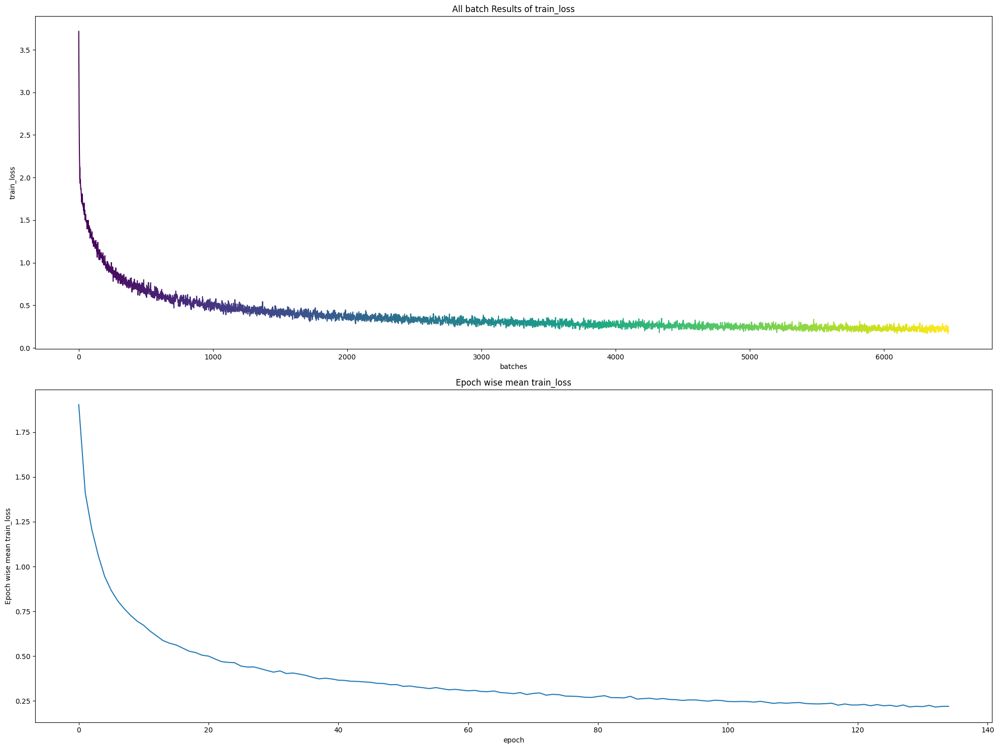

------------------------------------------------------------ Figure Below describres no_zero_e7_grad1 ------------------------------------------------------------


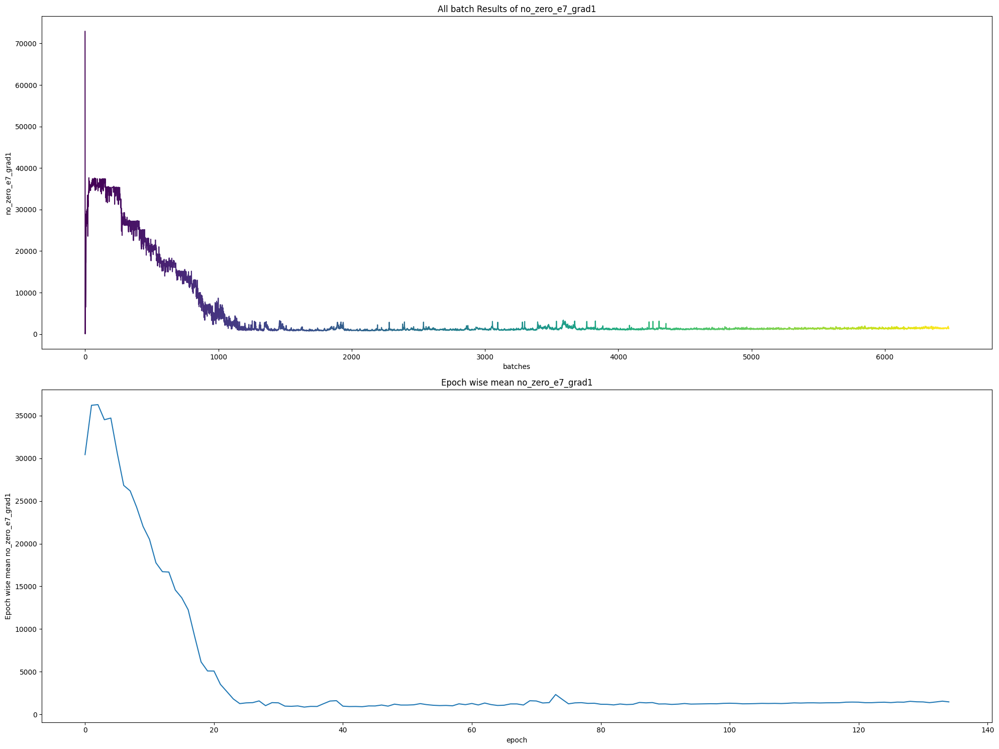

------------------------------------------------------------ Figure Below describres no_zero_e7_grad2 ------------------------------------------------------------


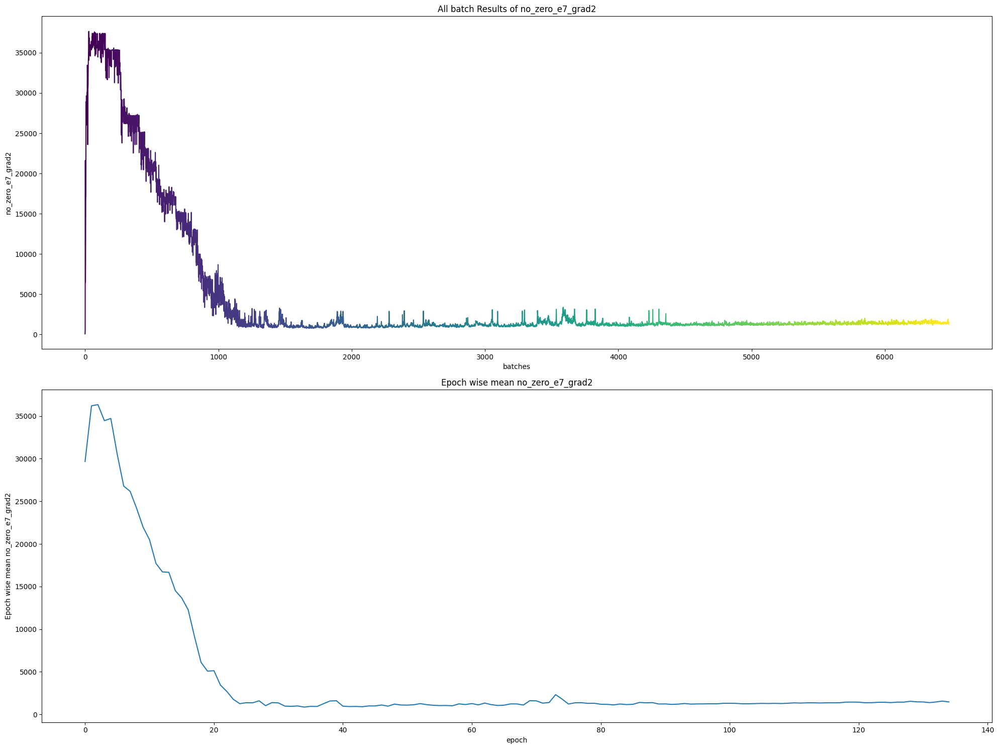

------------------------------------------------------------ Figure Below describres no_zero_e7_grad_retained ------------------------------------------------------------


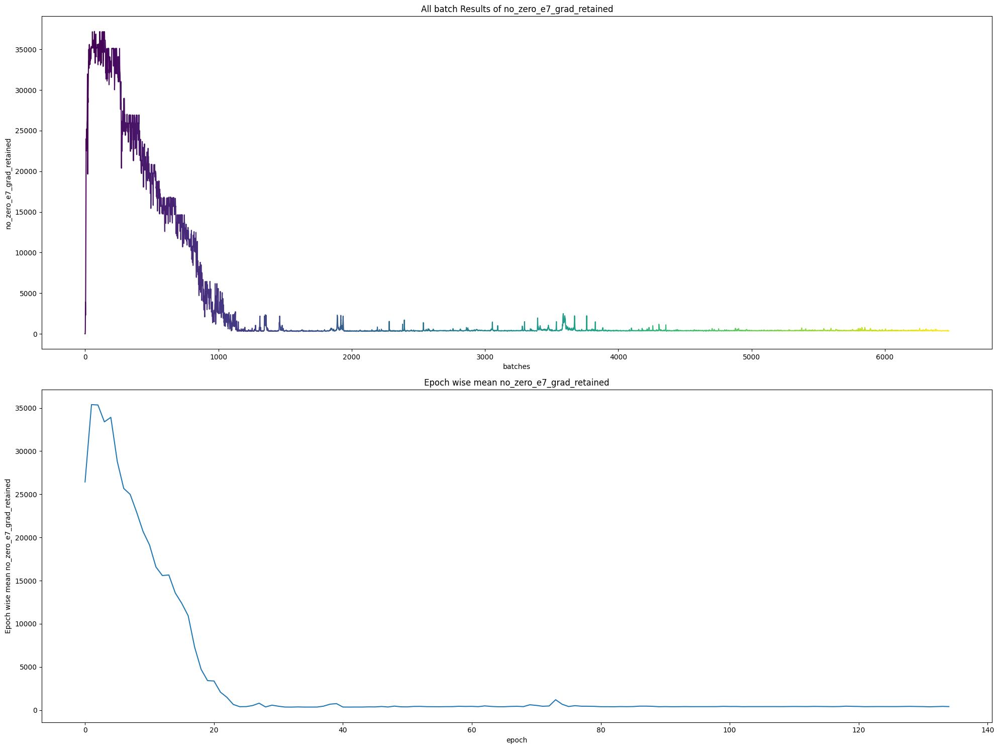

------------------------------------------------------------ Figure Below describres no_zero_e7_grad_released ------------------------------------------------------------


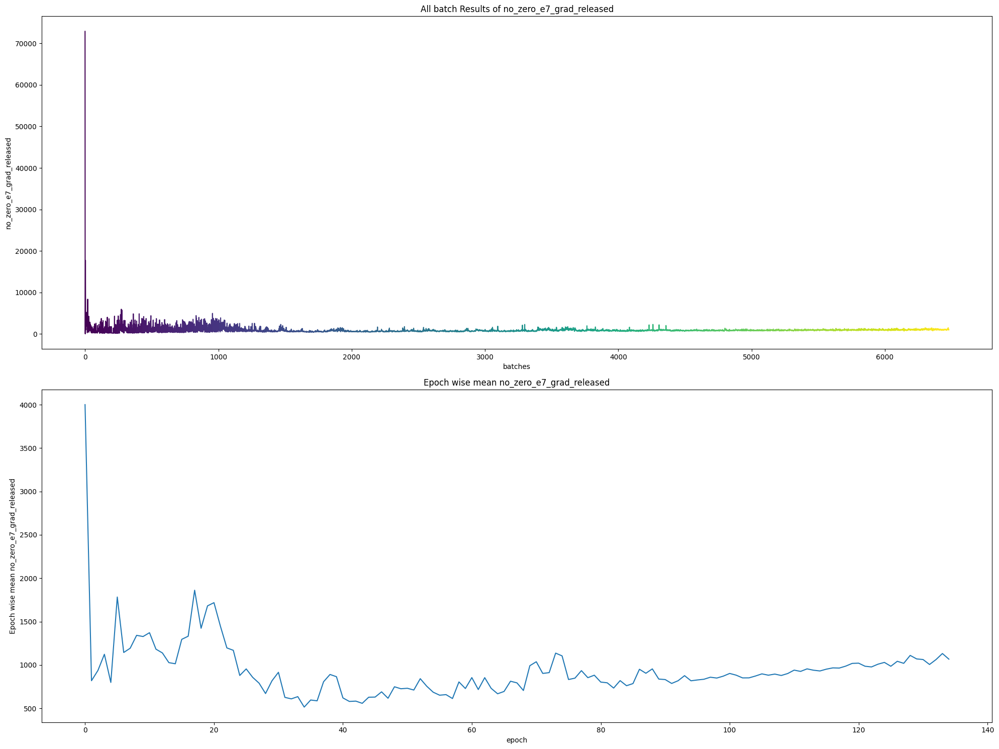

------------------------------------------------------------ Figure Below describres fraction_zeros_e7_released ------------------------------------------------------------


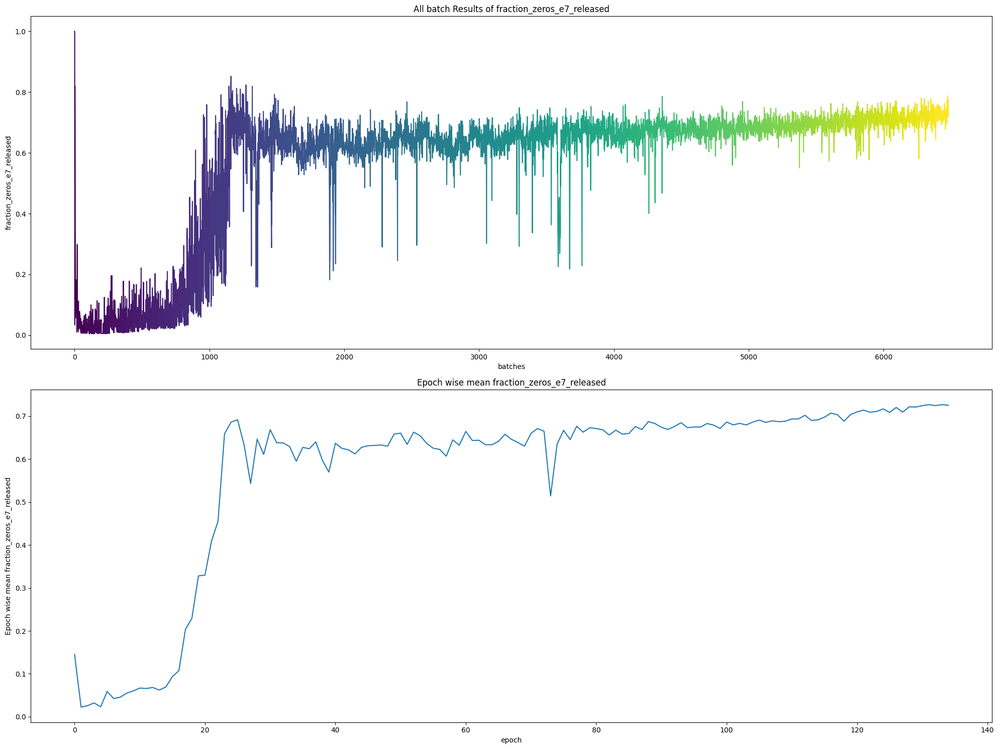

------------------------------------------------------------ Figure Below describres no_zero_e5_grad1 ------------------------------------------------------------


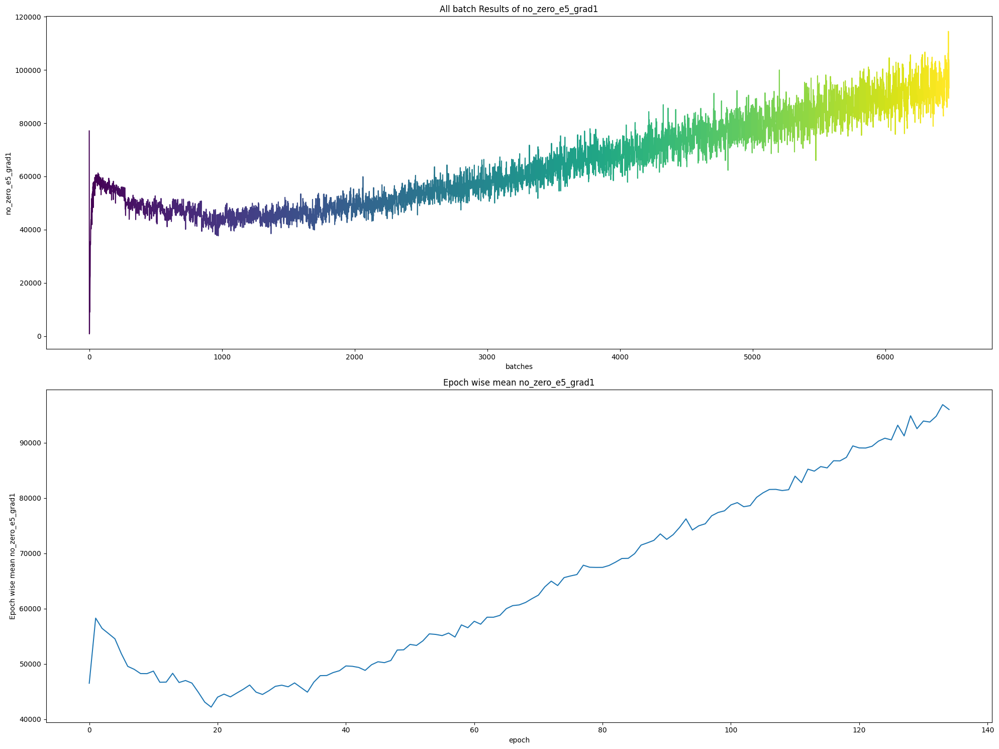

------------------------------------------------------------ Figure Below describres no_zero_e5_grad2 ------------------------------------------------------------


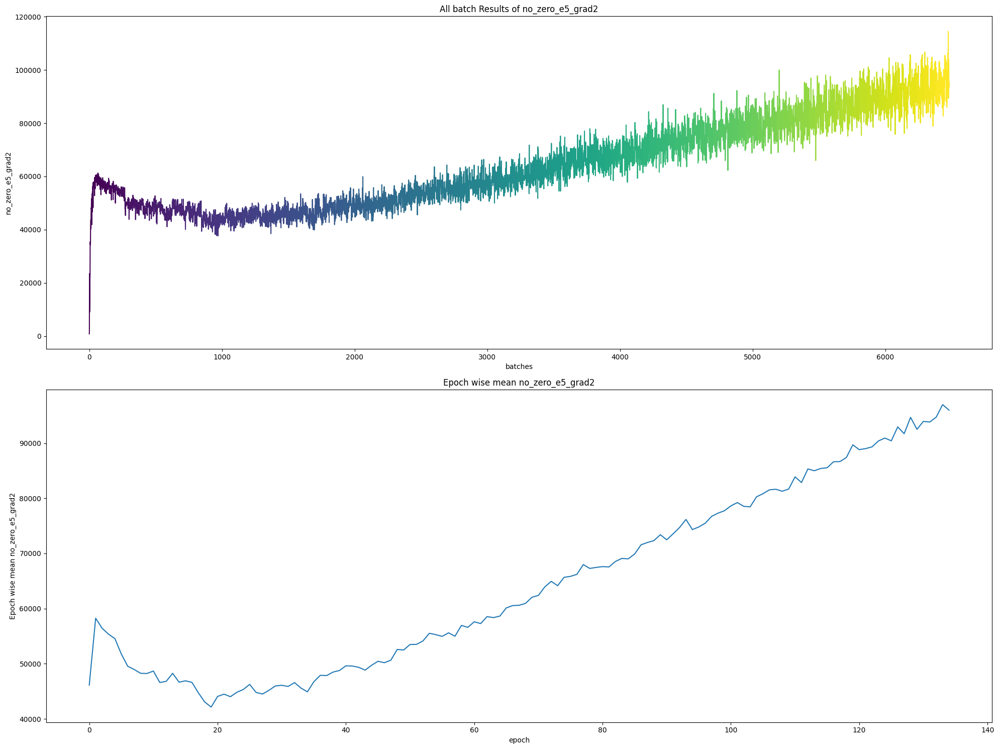

------------------------------------------------------------ Figure Below describres no_zero_e5_grad_retained ------------------------------------------------------------


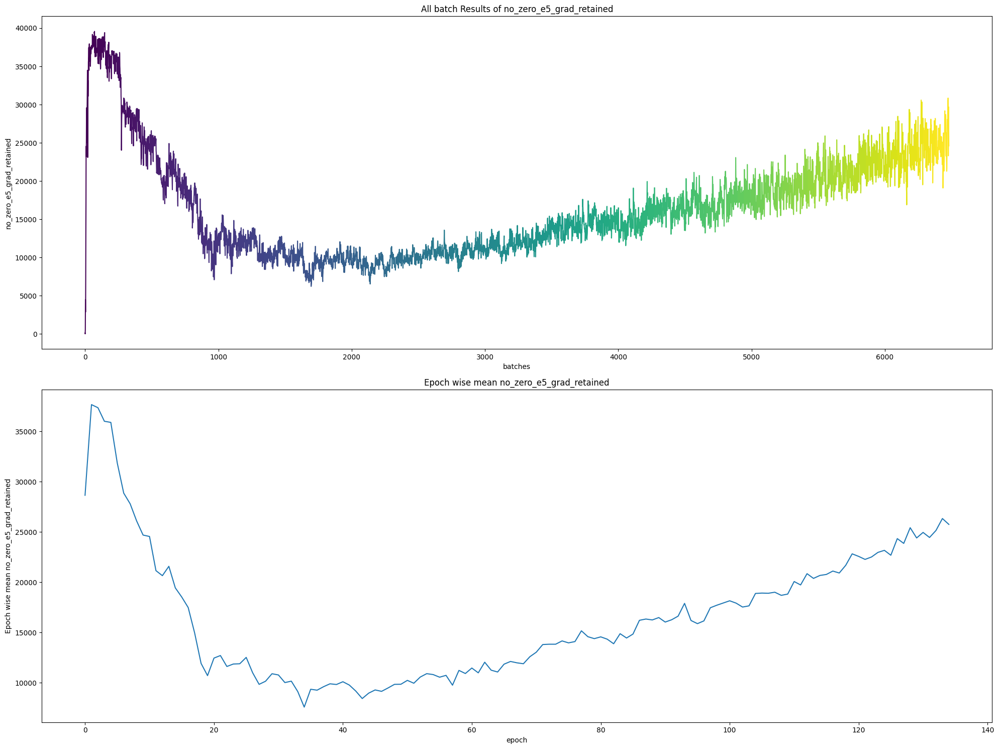

------------------------------------------------------------ Figure Below describres no_zero_e5_grad_released ------------------------------------------------------------


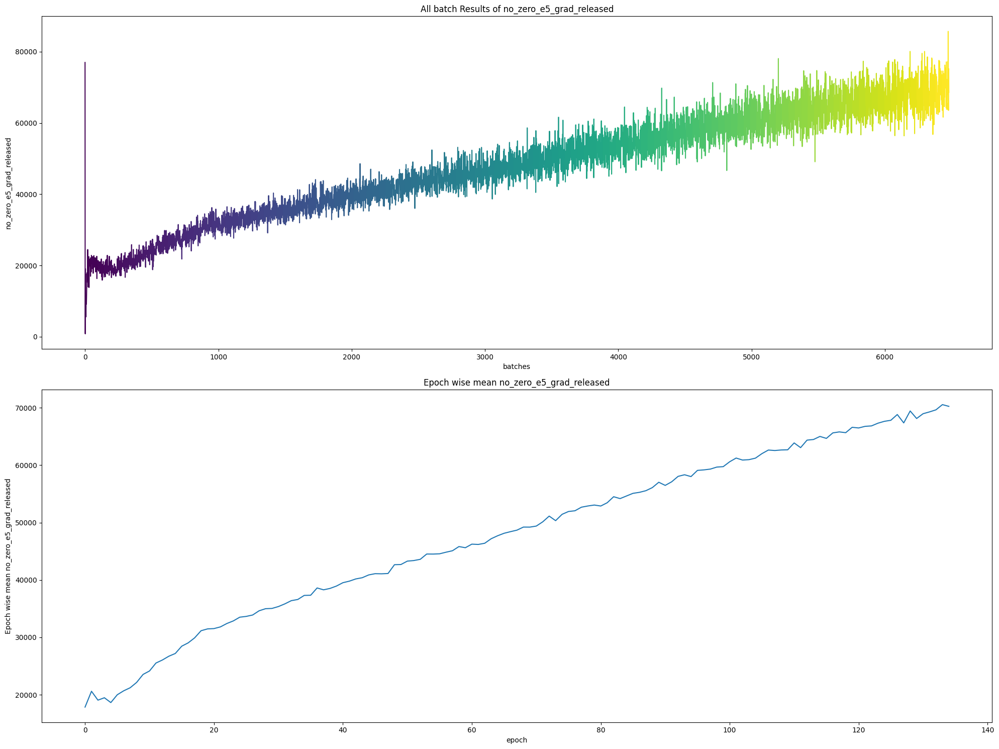

------------------------------------------------------------ Figure Below describres fraction_zeros_e5_released ------------------------------------------------------------


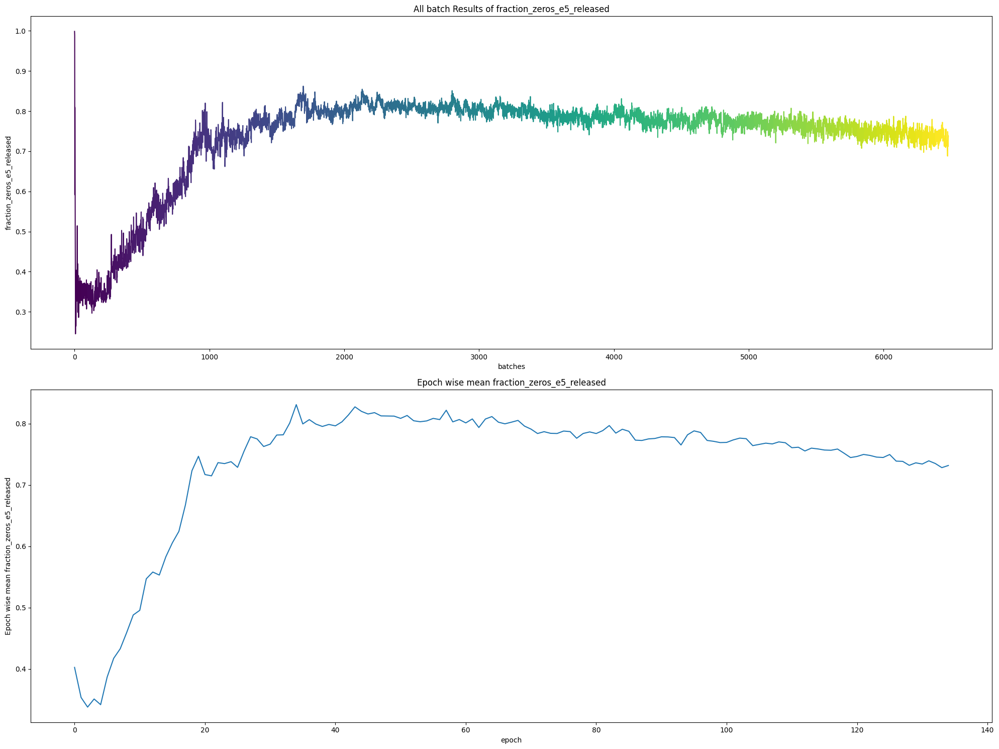

------------------------------------------------------------ Figure Below describres no_zero_e7_grad2_09avg ------------------------------------------------------------


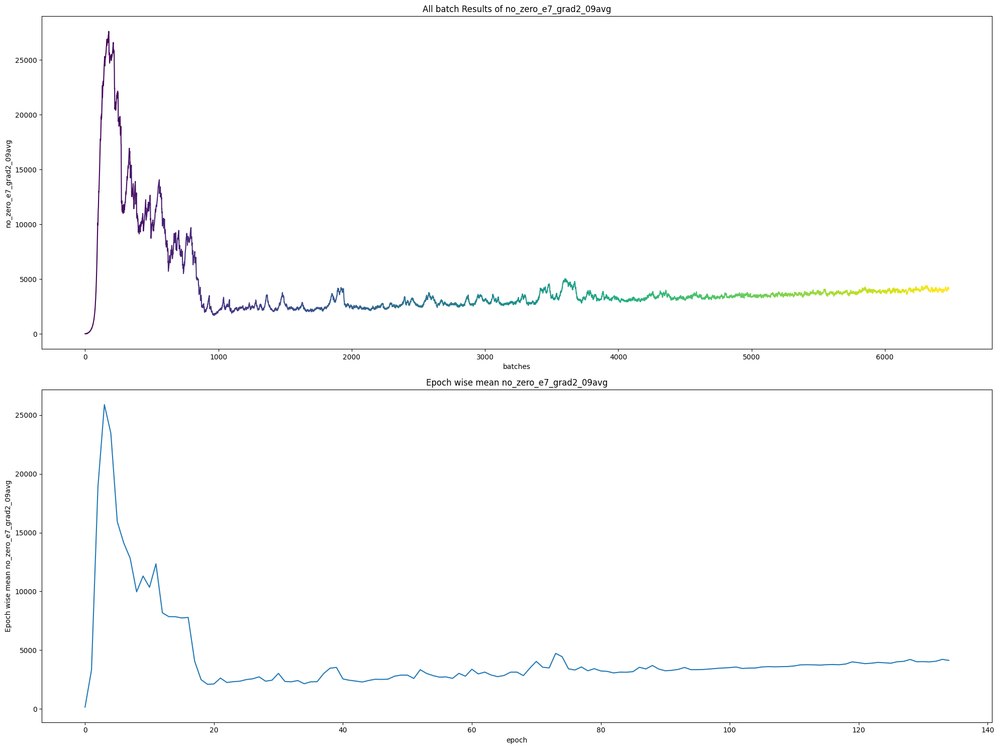

------------------------------------------------------------ Figure Below describres no_zero_e7_grad_released_09avg ------------------------------------------------------------


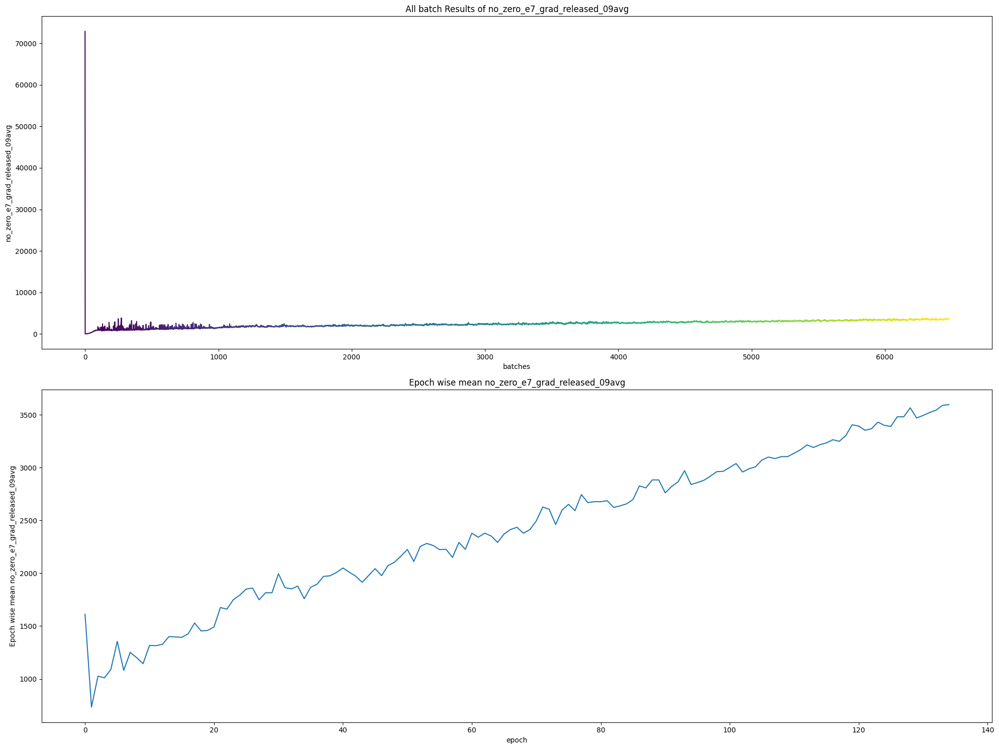

------------------------------------------------------------ Figure Below describres no_zero_e5_grad2_09avg ------------------------------------------------------------


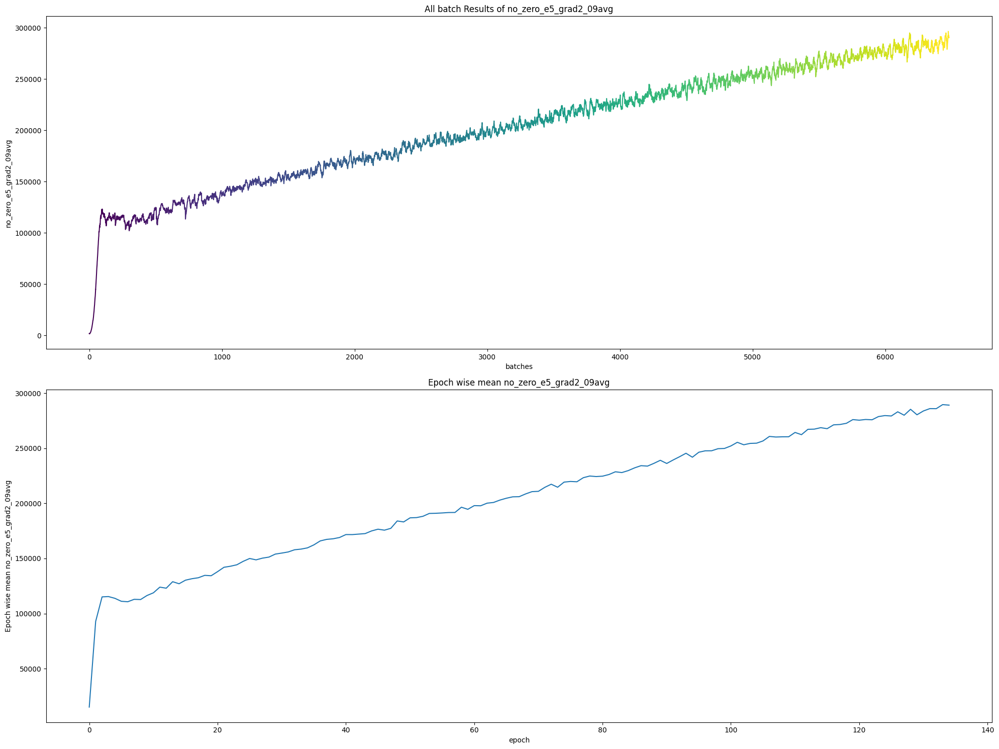

------------------------------------------------------------ Figure Below describres no_zero_e5_grad_released_09avg ------------------------------------------------------------


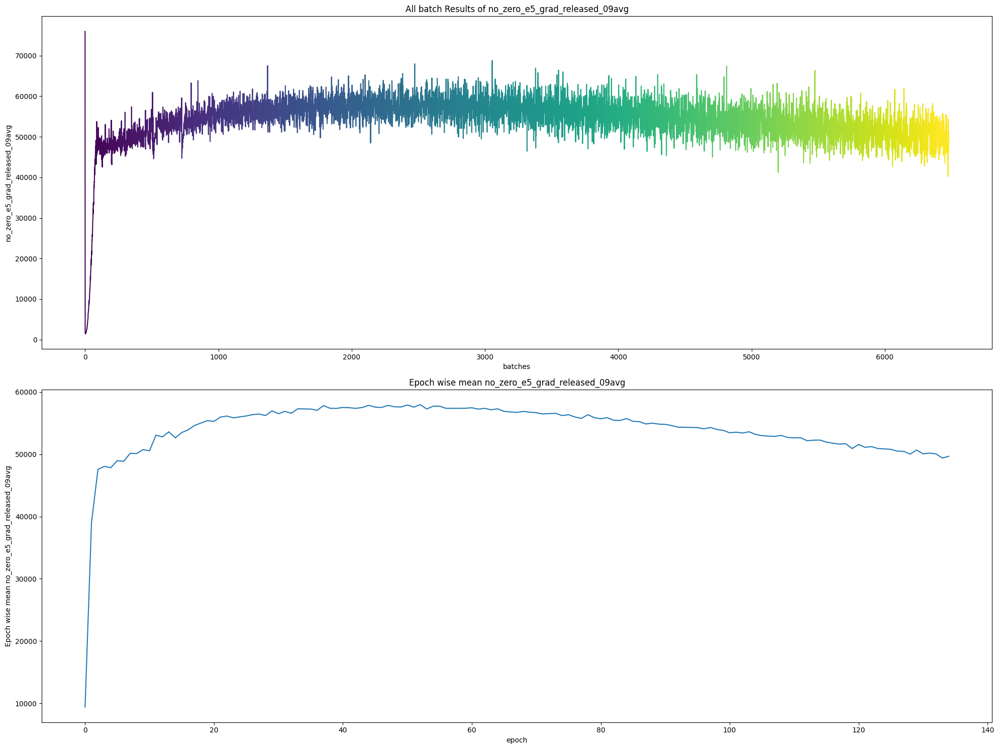

------------------------------------------------------------ Figure Below describres fraction_zeros_e7_released_09avg ------------------------------------------------------------


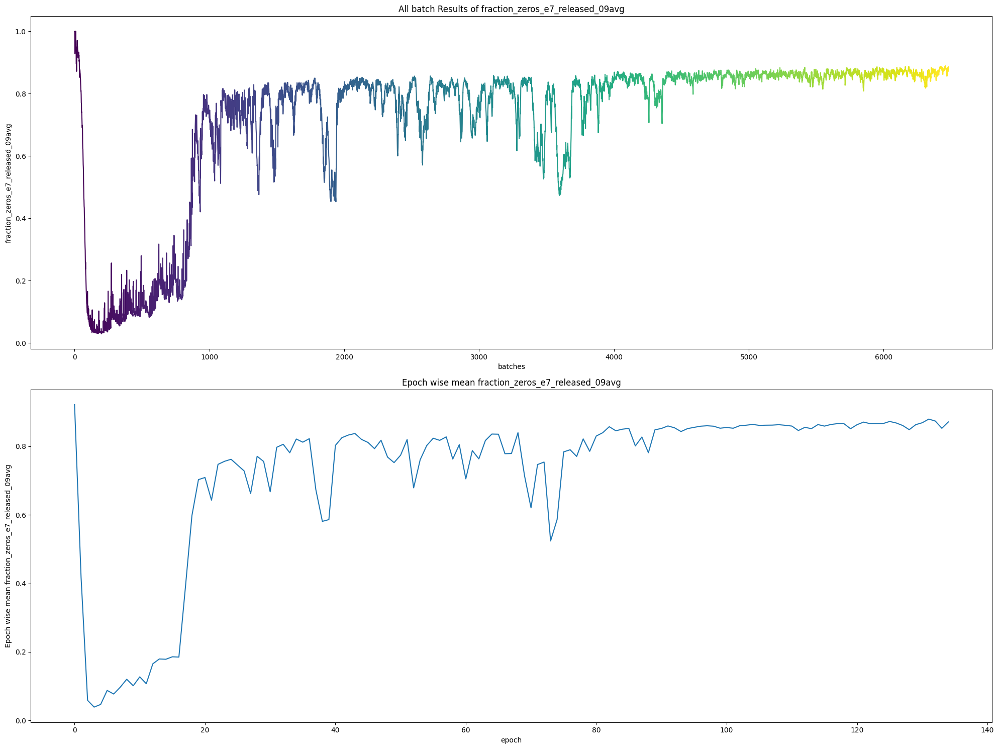

------------------------------------------------------------ Figure Below describres fraction_zeros_e5_released_09avg ------------------------------------------------------------


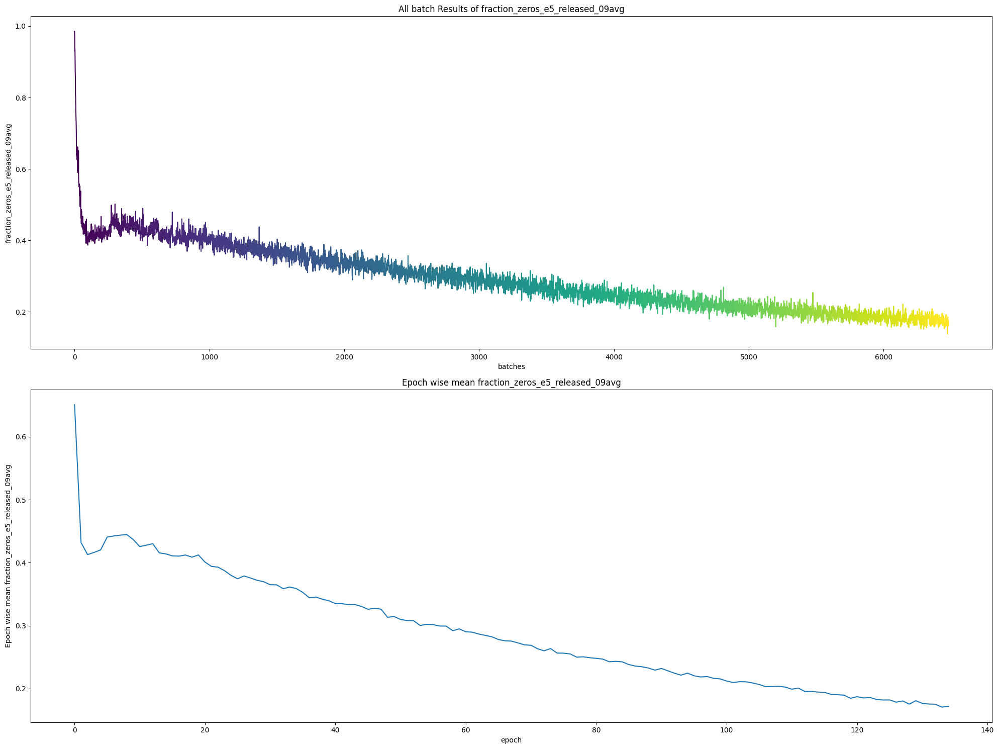

------------------------------------------------------------ Figure Below describres no_grad_flipped_e7 ------------------------------------------------------------


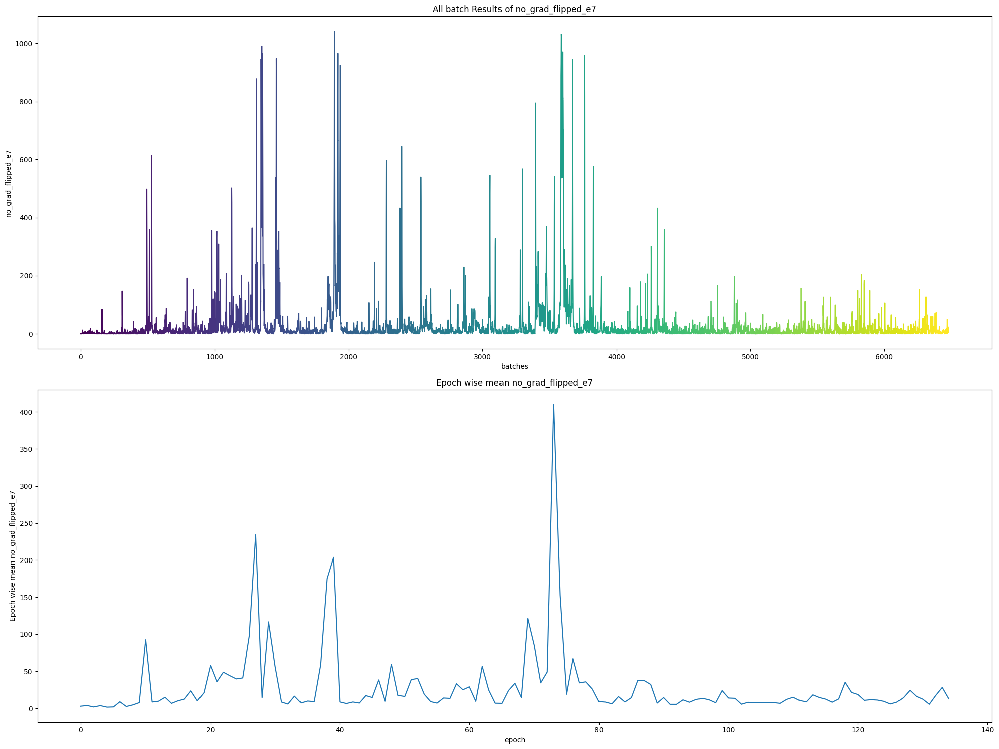

------------------------------------------------------------ Figure Below describres no_grad_flipped_e5 ------------------------------------------------------------


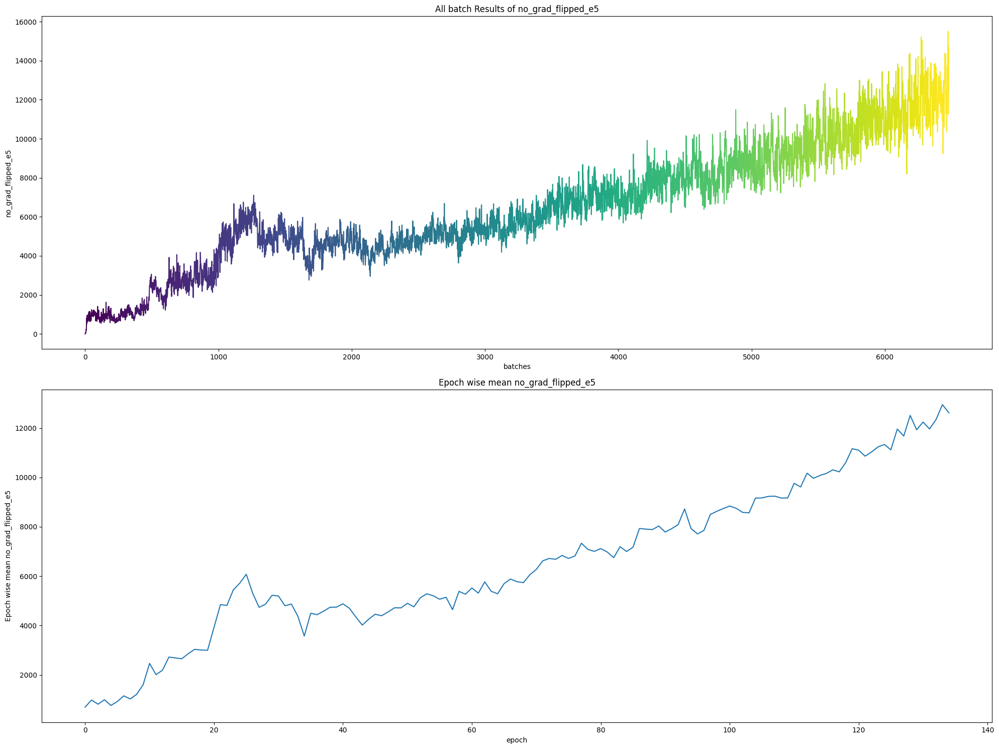

------------------------------------------------------------ Figure Below describres fraction_grad_flipped_e7 ------------------------------------------------------------


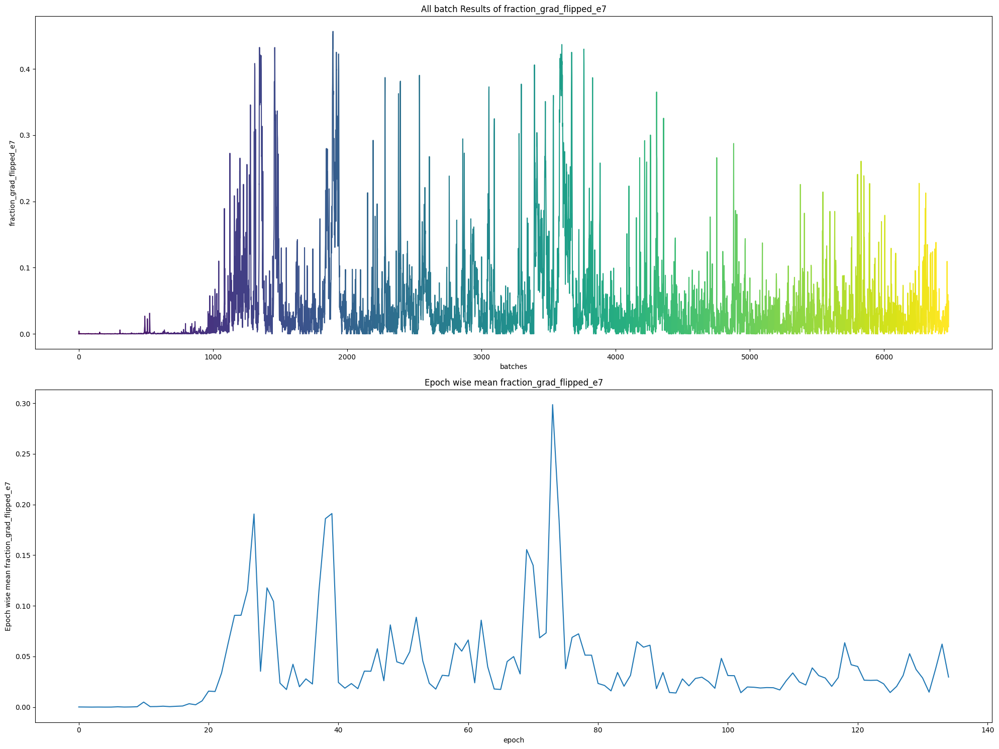

------------------------------------------------------------ Figure Below describres fraction_grad_flipped_e5 ------------------------------------------------------------


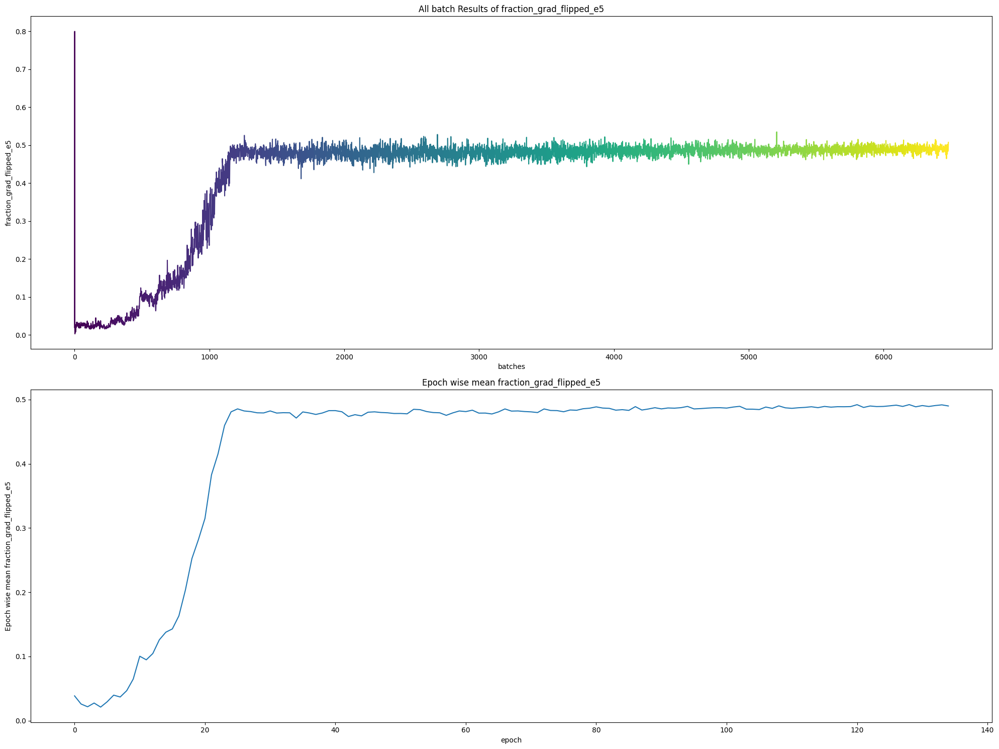

------------------------------------------------------------ Figure Below describres no_min_e7 ------------------------------------------------------------


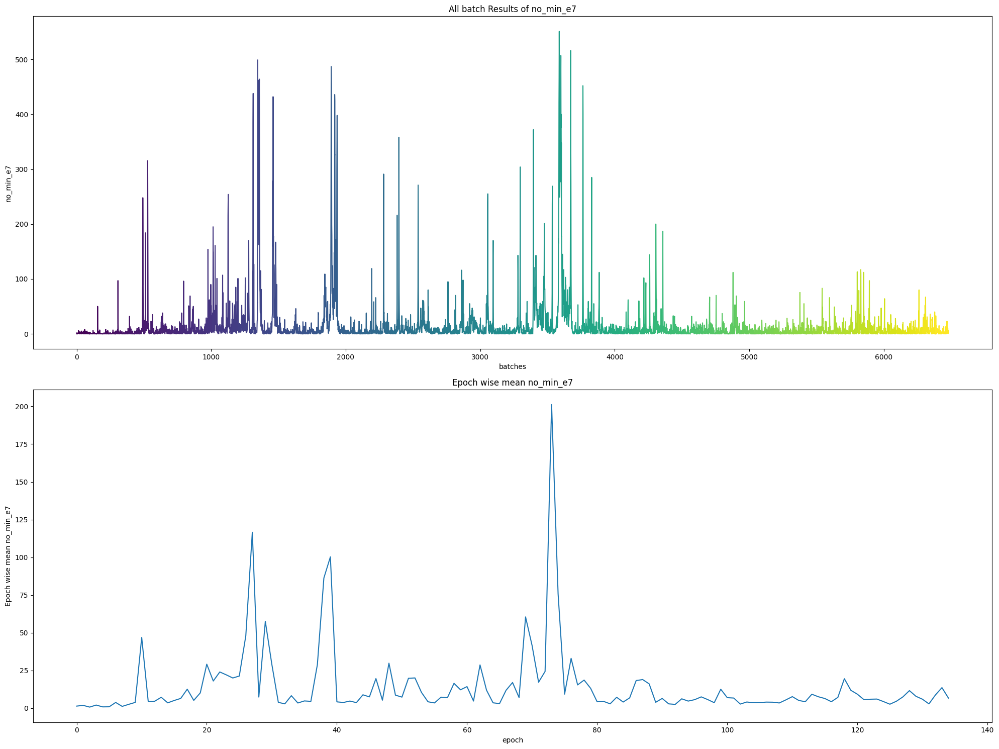

------------------------------------------------------------ Figure Below describres no_max_e7 ------------------------------------------------------------


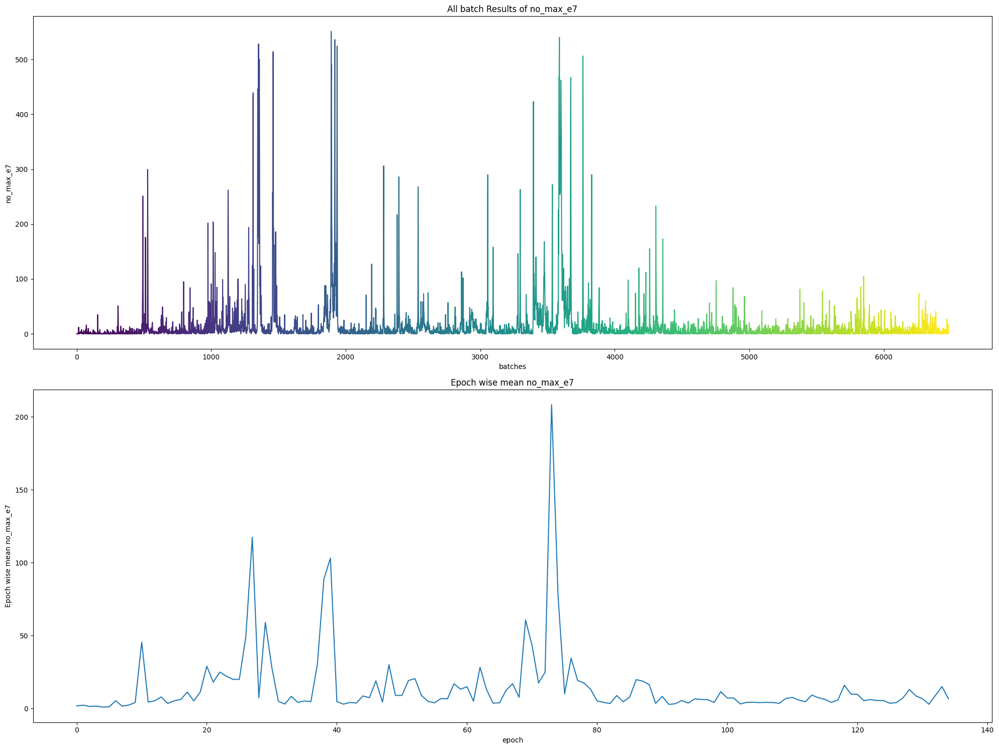

------------------------------------------------------------ Figure Below describres no_min_e5 ------------------------------------------------------------


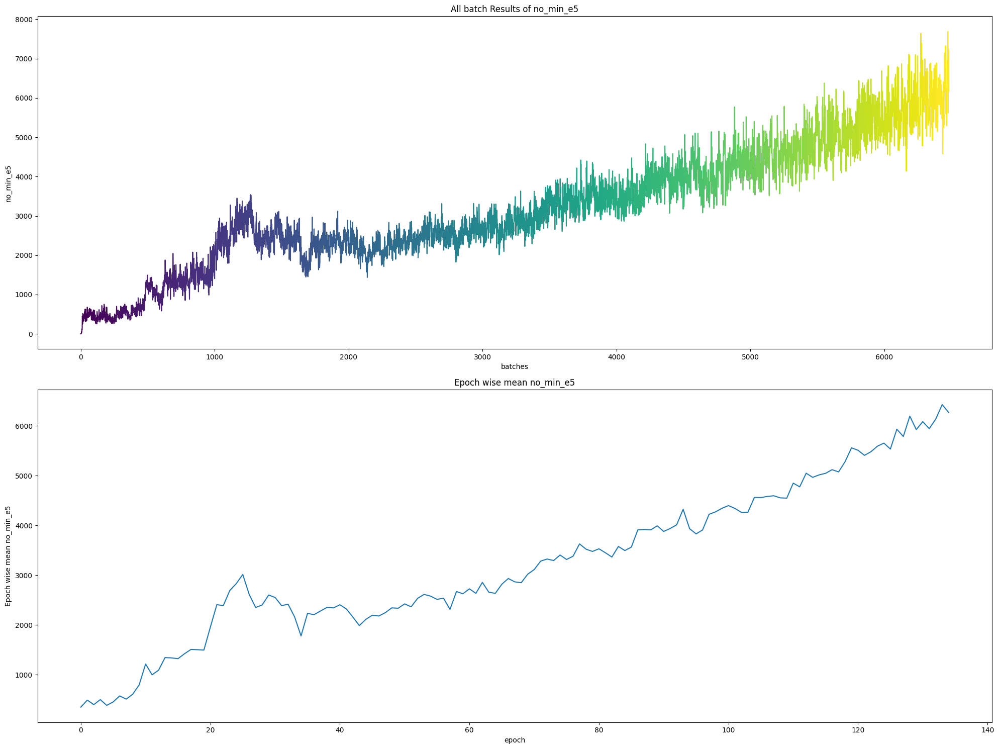

------------------------------------------------------------ Figure Below describres no_max_e5 ------------------------------------------------------------


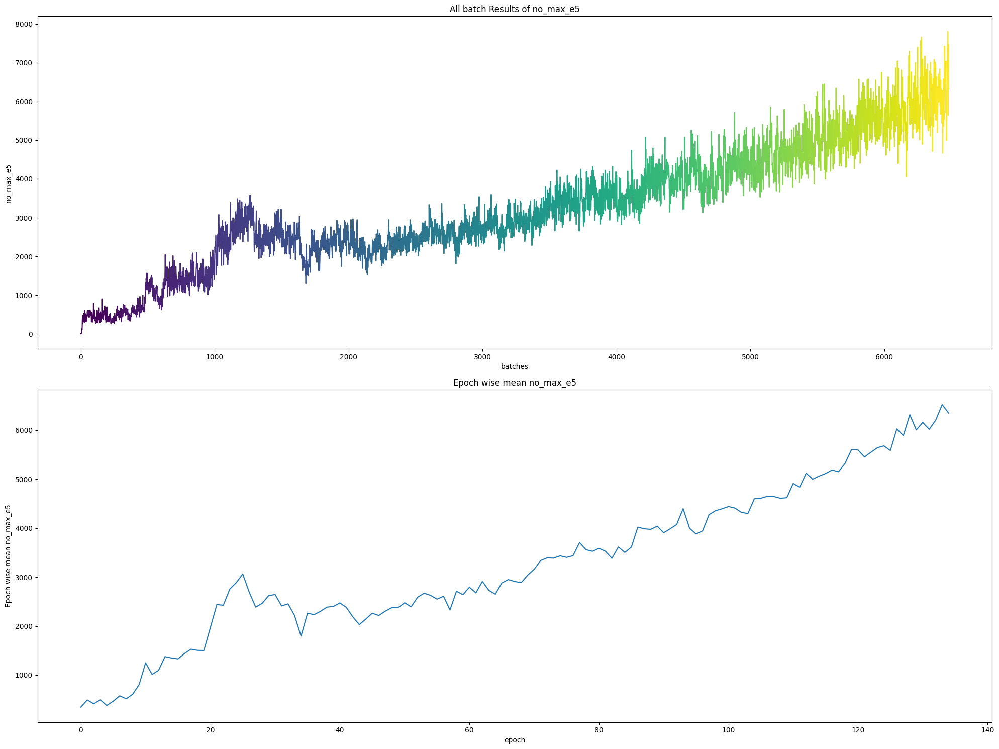

In [ ]:
for key,item in my_call_back.interim_results['batch_wise'].items():
  if 'hist' in key or 'pos' in key or 'w_diff' in key:
    continue
  print(f"{'-'*60} Figure Below describres {key} {'-'*60}")
  plot_epoch_results(data=item,y_label=key)

### Plotting Epoch wise mean of metrices

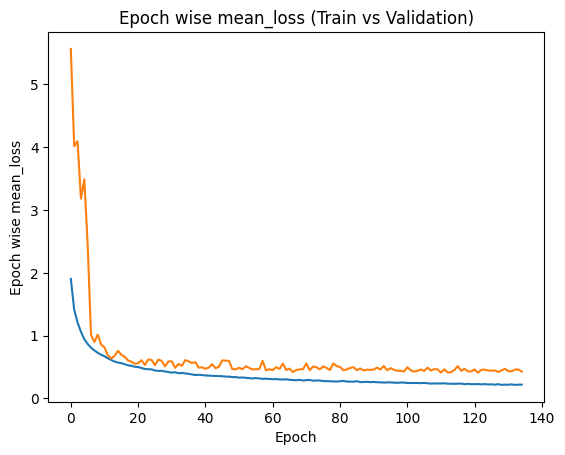

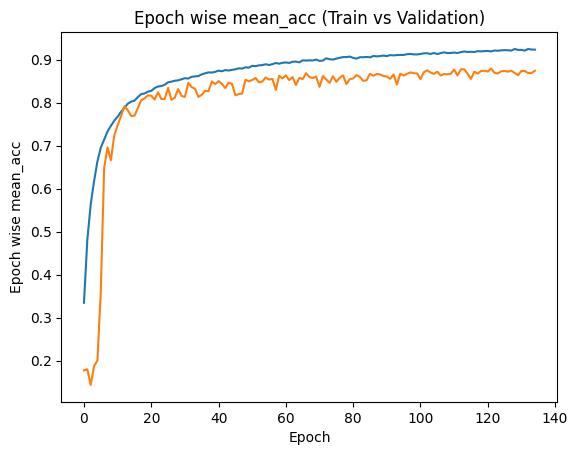

In [ ]:
plot_epoch_wise_mean_metrics(my_call_back.interim_results['epoch_wise'])

## Grad Hist

In [ ]:
# calculate_stats(my_call_back.interim_results['batch_wise']['g_cur_hist'][1][0])
# calculate_stats(my_call_back.interim_results['batch_wise']['g_cur_hist'][-2][0])

In [ ]:
# plot_histogram_from_dict(my_call_back.interim_results['batch_wise']['g_cur_hist'][1][0], show=True)

# plot_histogram_from_dict(my_call_back.interim_results['batch_wise']['g_cur_hist'][-2][-1], show=True)

# plt.show()

## Positional Data

In [ ]:
def plot_positional_data(data, title=None, x_label="# Gradient", y_label="# Batch * 20", figsize=(40,15), size=0.001, show=True):
  plt.figure(figsize=figsize)
  ind=0
  for epoch_wise_result in data:
    for batch_wise_result in epoch_wise_result:
      ind+=1
      plt.scatter(batch_wise_result,[ind]*len(batch_wise_result),s=size)

  plt.ylabel(y_label)
  plt.xlabel(x_label)
  plt.title(title)
  if show:
    plt.show()

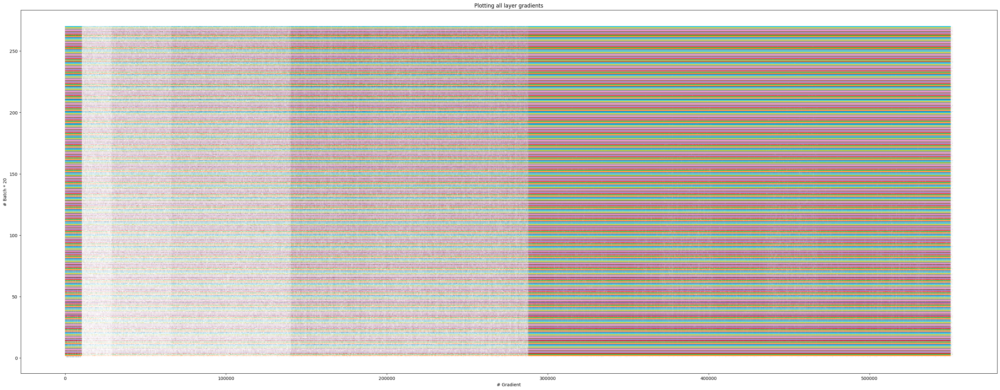

In [ ]:
plot_positional_data(my_call_back.interim_results['batch_wise']['pos_zero_e5_grad2'],
                     title="Plotting all layer zero gradients e5",
                     figsize=(40,15),
                     size=0.001,
                     show=True)

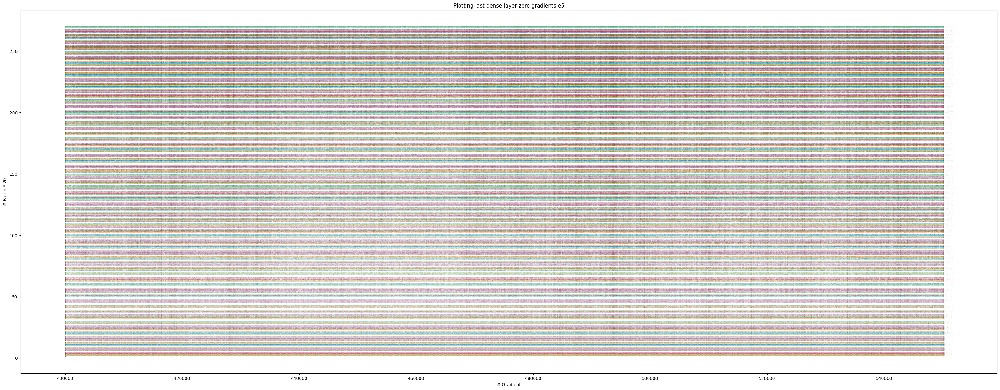

In [ ]:
clipped_data = [
    [np.clip(batch_wise_result, a_min=400000, a_max=None) for batch_wise_result in epoch_wise_result]
    for epoch_wise_result in my_call_back.interim_results['batch_wise']['pos_zero_e5_grad2']
]

plot_positional_data(clipped_data,
                     title="Plotting last dense layer zero gradients e5",
                     figsize=(40,15),
                     size=0.001,
                     show=True)

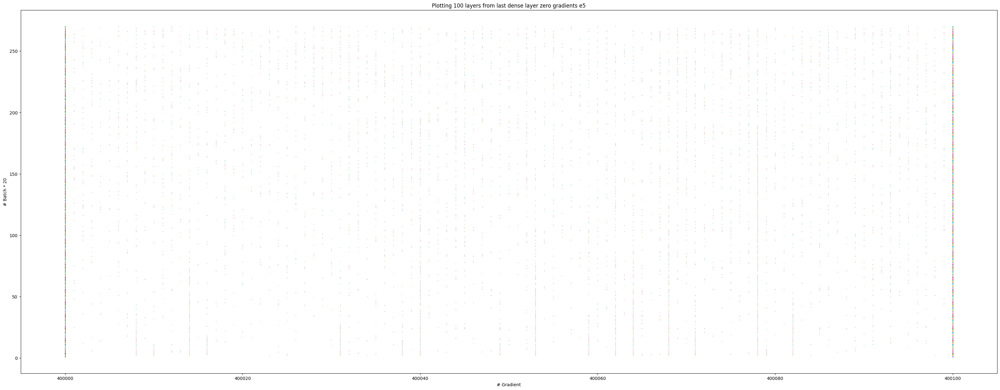

In [ ]:
clipped_data = [
    [np.clip(batch_wise_result, a_min=400000, a_max=400100) for batch_wise_result in epoch_wise_result]
    for epoch_wise_result in my_call_back.interim_results['batch_wise']['pos_zero_e5_grad2']
]

plot_positional_data(clipped_data,
                     title="Plotting 100 layers from last dense layer zero gradients e5",
                     figsize=(40,15),
                     size=0.1,
                     show=True)

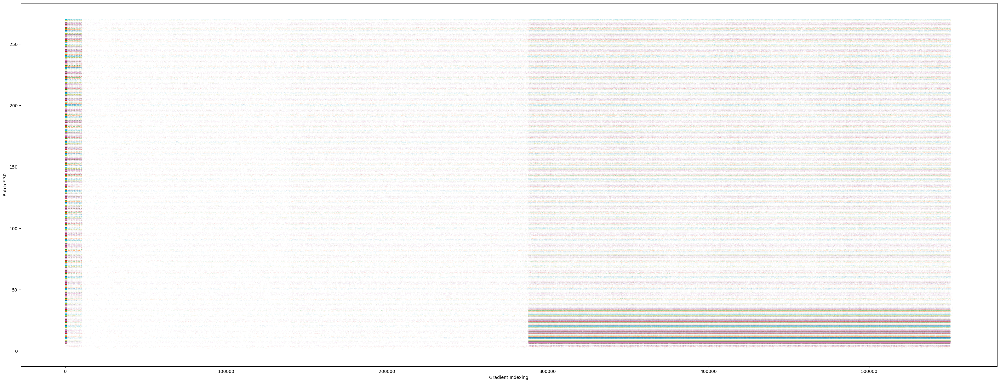

In [ ]:
plot_positional_data(my_call_back.interim_results['batch_wise']['pos_zero_e7_grad2'],
                     title="Plotting all layer zero gradients e7",
                     figsize=(40,15),
                     size=0.001,
                     show=True)

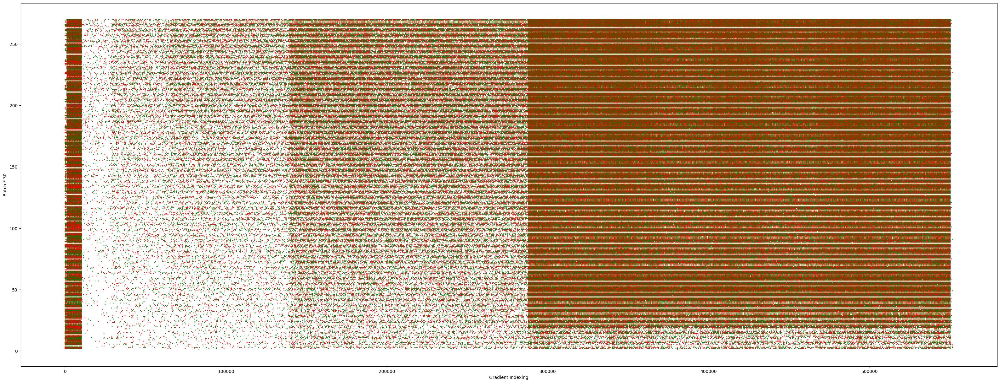

In [ ]:
plt.figure(figsize=(40,15))
ind=0
for epoch_wise_result_flag,epoch_wise_result_mm in zip(my_call_back.interim_results['batch_wise']['pos_grad_0_0_e5'], my_call_back.interim_results['batch_wise']['pos_min_max_0_0_e5']):
  for batch_wise_result_flag,batch_wise_result_mm in zip(epoch_wise_result_flag,epoch_wise_result_mm):
    ind+=1
    color_map = {0: 'black', -1: 'red', 1: 'green'}
    colors = [color_map[mm] for mm in batch_wise_result_mm if mm !=0 ]
    batch_wise_result_flag_clipped = np.array(batch_wise_result_flag)[np.array(batch_wise_result_mm)!=0].tolist()
    plt.scatter(batch_wise_result_flag_clipped,[ind]*len(batch_wise_result_flag_clipped),s=1, c=colors)

plt.ylabel("Batch * 30")
plt.xlabel("Gradient Indexing")
plt.show()

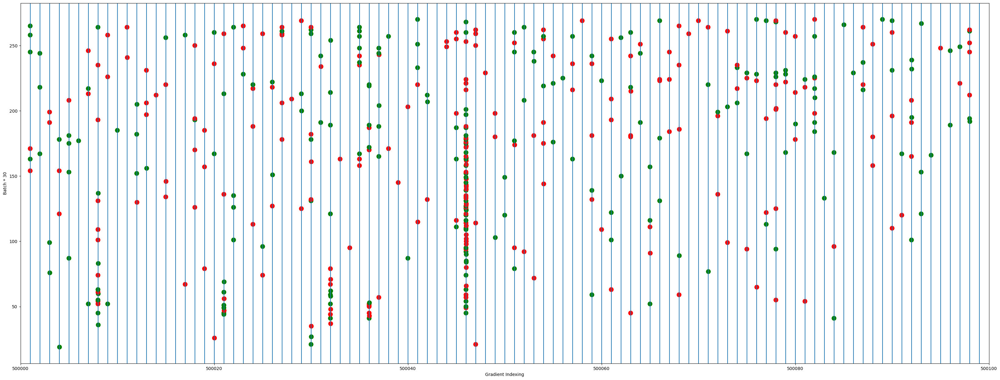

In [ ]:
plt.figure(figsize=(40,15))
ind=0
x_lim_range=(500000,500100)
for x in range(x_lim_range[0],x_lim_range[1]):
  plt.axvline(x)
plt.xlim(x_lim_range)
for epoch_wise_result_flag,epoch_wise_result_mm in zip(my_call_back.interim_results['batch_wise']['pos_grad_0_0_e5'], my_call_back.interim_results['batch_wise']['pos_min_max_0_0_e5']):
  for batch_wise_result_flag,batch_wise_result_mm in zip(epoch_wise_result_flag,epoch_wise_result_mm):
    ind+=1
    color_map = {0: 'black', -1: 'red', 1: 'green'}
    colors = np.array([color_map[mm] for mm in batch_wise_result_mm if mm !=0 ])
    batch_wise_result_flag_clipped = np.array(batch_wise_result_flag)[np.array(batch_wise_result_mm)!=0]
    colors = colors[np.where((batch_wise_result_flag_clipped>x_lim_range[0]) & (batch_wise_result_flag_clipped<x_lim_range[1]))[0]].tolist()
    batch_wise_result_flag_clipped = batch_wise_result_flag_clipped[np.where((batch_wise_result_flag_clipped>x_lim_range[0]) & (batch_wise_result_flag_clipped<x_lim_range[1]))[0]].tolist()
    plt.scatter(batch_wise_result_flag_clipped,[ind]*len(batch_wise_result_flag_clipped),s=100, c=colors)
plt.ylabel("Batch * 30")
plt.xlabel("Gradient Indexing")
plt.show()

In [ ]:
print([ind]*len(batch_wise_result_flag_clipped))
print(batch_wise_result_flag_clipped)

[]
[]


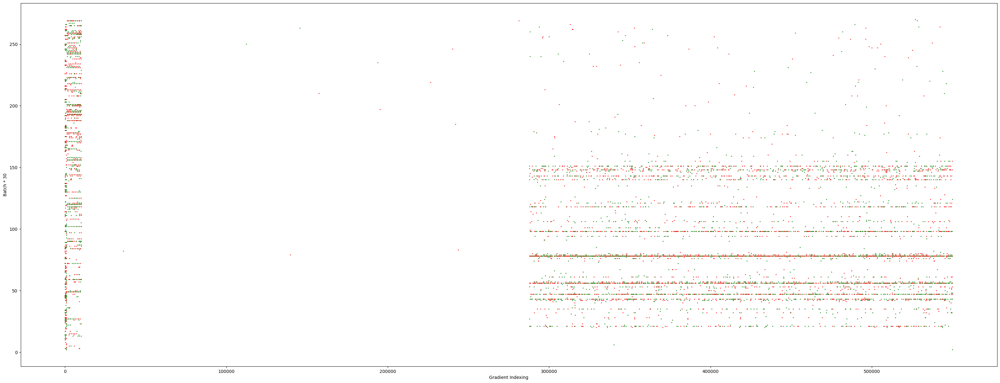

In [ ]:
plt.figure(figsize=(40,15))
ind=0
for epoch_wise_result_flag,epoch_wise_result_mm in zip(my_call_back.interim_results['batch_wise']['pos_grad_0_0_e7'], my_call_back.interim_results['batch_wise']['pos_min_max_0_0_e7']):
  for batch_wise_result_flag,batch_wise_result_mm in zip(epoch_wise_result_flag,epoch_wise_result_mm):
    ind+=1
    color_map = {0: 'black', -1: 'red', 1: 'green'}
    colors = [color_map[mm] for mm in batch_wise_result_mm if mm !=0 ]
    batch_wise_result_flag_clipped = np.array(batch_wise_result_flag)[np.array(batch_wise_result_mm)!=0].tolist()
    plt.scatter(batch_wise_result_flag_clipped,[ind]*len(batch_wise_result_flag_clipped),s=1, c=colors)

plt.ylabel("Batch * 30")
plt.xlabel("Gradient Indexing")
plt.show()

## Stats Weight Diff (Grad Flipped vs No Grad Flipped)

In [ ]:
batch_wise_no_flips_data=[]
batch_wise_flips_data=[]
for epoch_wise_result_w_diff, epoch_wise_result_pos_minmax in zip(my_call_back.interim_results['batch_wise']['w_diff_0_0_e5'], my_call_back.interim_results['batch_wise']['pos_min_max_0_0_e5']):
  batch_wise_no_flips_data.append([])
  batch_wise_flips_data.append([])
  for batch_wise_result_w_diff, batch_wise_result_pos_minmax in zip(epoch_wise_result_w_diff, epoch_wise_result_pos_minmax):
    batch_wise_no_flips_data[-1].append(np.mean(np.array(batch_wise_result_w_diff)[np.array(batch_wise_result_pos_minmax)==0]))
    batch_wise_flips_data[-1].append(np.mean(np.array(batch_wise_result_w_diff)[np.array(batch_wise_result_pos_minmax)!=0]))

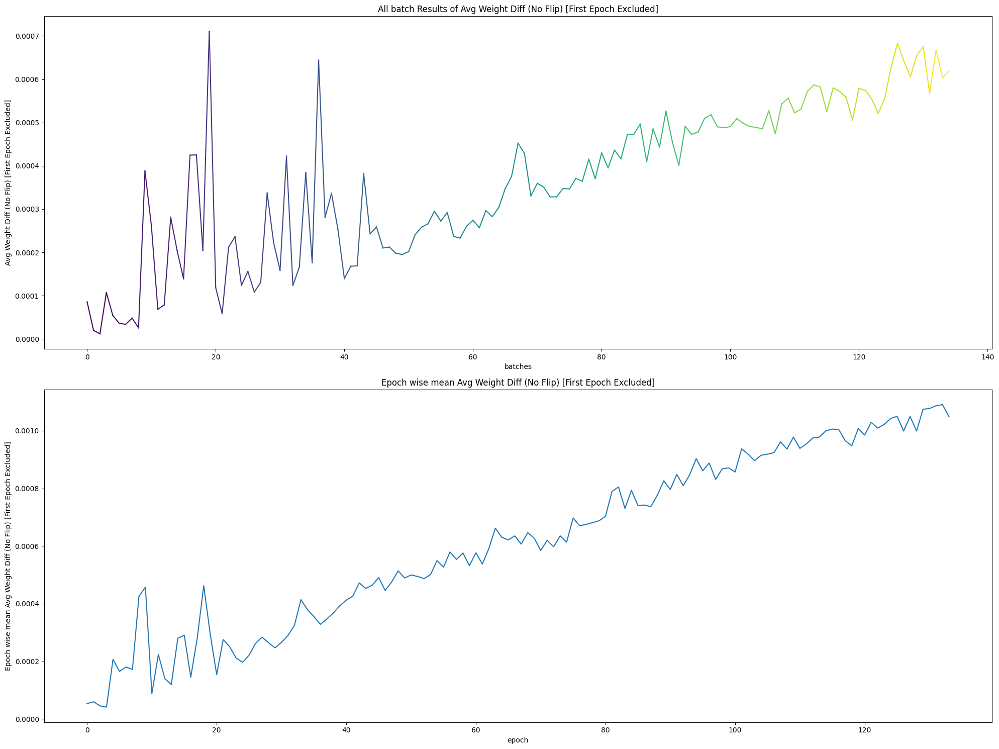

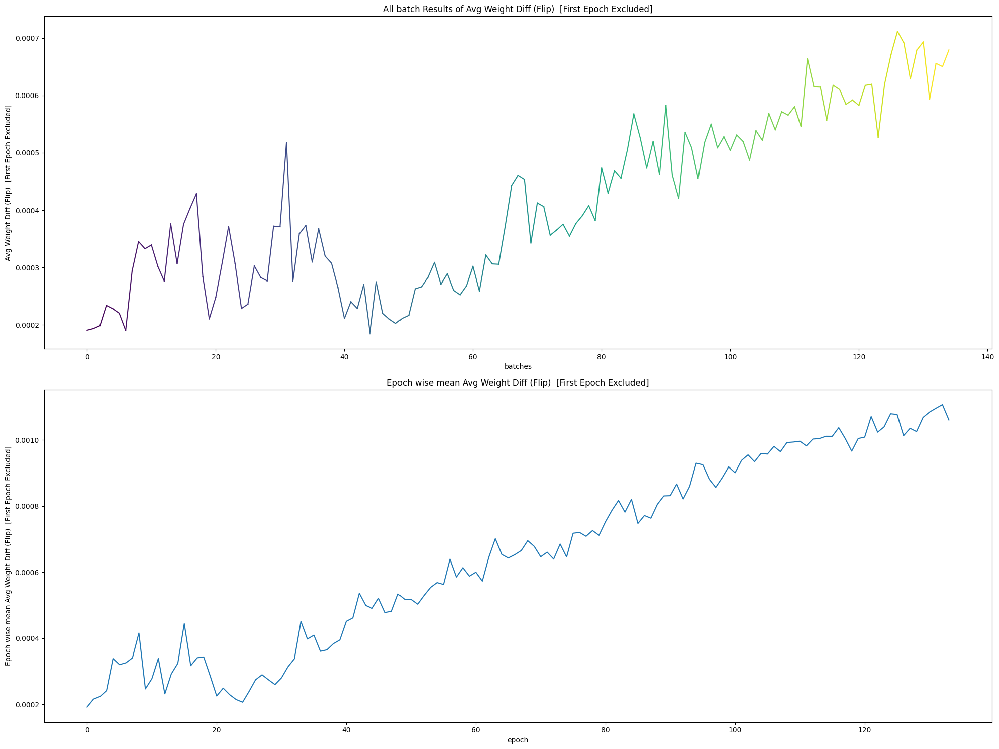

In [ ]:
plot_epoch_results(data=batch_wise_no_flips_data[1:], y_label="Avg Weight Diff (No Flip) [First Epoch Excluded]")
plot_epoch_results(data=batch_wise_flips_data[1:], y_label="Avg Weight Diff (Flip)  [First Epoch Excluded]")

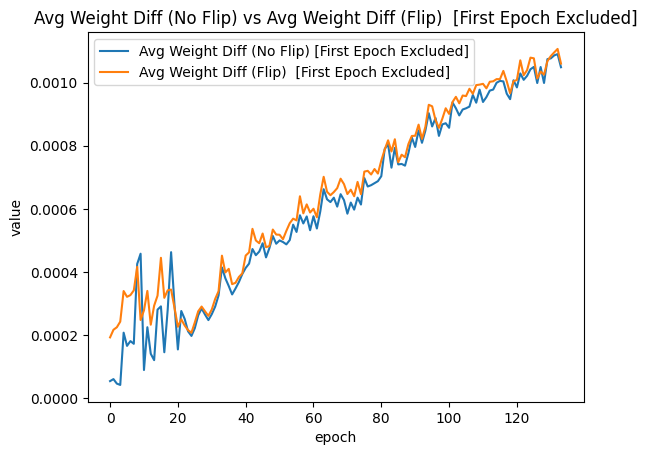

In [ ]:
plot_common(data=[np.mean(_) for _ in batch_wise_no_flips_data[1:]],label="Avg Weight Diff (No Flip) [First Epoch Excluded]", show=False)
plot_common(data=[np.mean(_) for _ in batch_wise_flips_data[1:]],label="Avg Weight Diff (Flip)  [First Epoch Excluded]", show=False)
plt.title("Avg Weight Diff (No Flip) vs Avg Weight Diff (Flip)  [First Epoch Excluded]")
plt.legend()
plt.show()

In [ ]:
"""
Adam:
w2=w1-(lr*grad/rms2)    rms->2nd order momentum; grad-> 1st order momentum

"""

## Tensorboard

In [ ]:
## For manually updating the log directory
# my_call_back.update_logs_directory()

In [ ]:
%tensorboard --logdir /content/logs/

<IPython.core.display.Javascript object>

In [ ]:
 # https://jxooc9a4j792-496ff2e9c6d22116-6006-colab.googleusercontent.com/?tensorboardColab=true

In [ ]:
"""
f(x,y,z) = x^2 - xy + z^2

df/dx = 0
df/dy =
df/dz =

df/d(g(x,y)) = 0

grad f = [0 7.9 -9.7]
fx = 0



fxx fyx fzx
fxy fyy fzy
fxz fyz fzz

"""

In [ ]:
# 1st epoch:
# 1-> 99
# 2->101
# 3-> 99
# 4-> 101